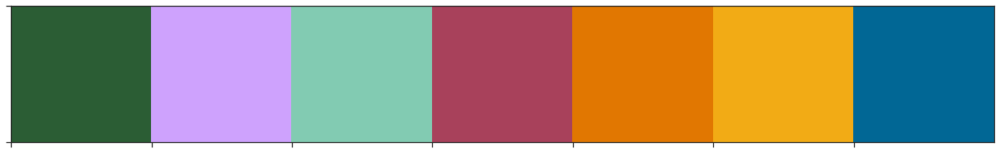

In [2]:
from Concept_Network import *
from Analysis import *
import matplotlib.pyplot as plt
from matplotlib import pylab
from matplotlib import colors
from matplotlib.colors import LogNorm
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.patches as patches
import itertools
import powerlaw
from nltk.collocations import *
import traces
import pingouin as pg
import matplotlib
from matplotlib import font_manager 
plt.rc('font', family='sans-serif') 
plt.rc('font', serif='Helvetica') 
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
import seaborn as sns

%matplotlib inline
%load_ext autoreload
%autoreload 2

scheme = sns.xkcd_palette(['pine', 'lilac', 'pale teal','light burgundy',
                              'pumpkin', 'squash', 'peacock blue'])#'
sns.palplot(scheme, size=(3))

Let's load the filtration matrices and barcodes for the texts.

In [3]:
sent_filts = load_sent_filts()
sent_bars = load_sent_bars()
text_lens = load_n_sents()

# RESULTS PART 3

We start with just an example barcode (we use Strang):

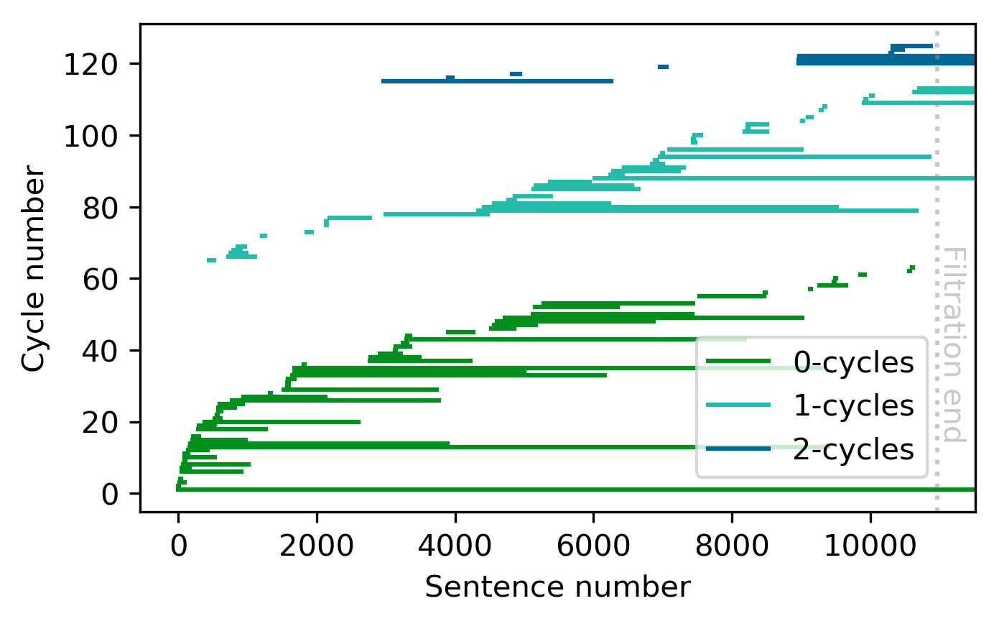

In [57]:
plt.figure(figsize=(5, 3), dpi=300)
plot_barcode(sent_bars[9], text_lens[9])
plt.savefig('figures/strang_barcode.pdf', transparent=True, bbox_inches='tight')

In [3]:
load_index_labels()[9]

array(['matrices', 'elimination', 'gauss', 'gaussian elimination',
       'linear algebra', 'linear equation', 'equation', 'linear',
       'algebra', 'determinant', 'subtract', 'second equation',
       'substitution', 'scientific computing', 'compute', 'left side',
       'cramer rule', 'algorithm', 'matrix', 'simplify', 'geometry',
       'dimension', 'dimensional', 'dimensional space', 'intersect',
       'vector', 'upper triangular', 'triangular', 'multiply',
       'triangular matrix', 'factorization', 'multiplication',
       'transpose', 'inverse', 'exceptional', 'singular', 'singular case',
       'infinitely', 'elimination step', 'subtraction', 'computer',
       'roundoff', 'roundoff error', 'row exchange', 'coefficient',
       'coefficient matrix', 'intersection', 'row picture',
       'column picture', 'linear system', 'vector equation',
       'column vector', 'time column', 'parallelogram', 'geometrically',
       'algebraically', 'three plane', 'three equation',
      

In [63]:
sent_filts[9][:5, :5]

array([[1.000e+00, 1.000e+00, 1.000e+00, 1.000e+00,       inf],
       [1.000e+00, 1.000e+00, 1.000e+00, 1.000e+00, 1.704e+03],
       [1.000e+00, 1.000e+00, 1.000e+00, 1.000e+00,       inf],
       [1.000e+00, 1.000e+00, 1.000e+00, 1.000e+00,       inf],
       [      inf, 1.704e+03,       inf,       inf, 2.000e+00]])

In [59]:
sent_bars[9][0]

array([0,
       array([[2.0000e+00, 6.0000e+00],
       [3.6000e+01, 3.9000e+01],
       [3.2000e+01, 4.1000e+01],
       [2.2000e+01, 9.0000e+01],
       [8.7000e+01, 1.0500e+02],
       [9.4000e+01, 1.4700e+02],
       [5.3000e+01, 1.6500e+02],
       [2.3200e+02, 2.3300e+02],
       [2.1100e+02, 3.0000e+02],
       [1.4800e+02, 4.2600e+02],
       [9.3000e+01, 5.3100e+02],
       [3.0300e+02, 5.3200e+02],
       [5.6100e+02, 5.6600e+02],
       [5.2500e+02, 6.1100e+02],
       [5.7800e+02, 6.2400e+02],
       [5.8400e+02, 8.1500e+02],
       [4.5000e+01, 9.1600e+02],
       [5.9600e+02, 9.2900e+02],
       [2.0600e+02, 9.7000e+02],
       [6.6000e+01, 1.0160e+03],
       [2.9100e+02, 1.2670e+03],
       [1.3300e+03, 1.3390e+03],
       [1.5770e+03, 1.5910e+03],
       [1.5780e+03, 1.5920e+03],
       [1.5840e+03, 1.6790e+03],
       [1.8100e+03, 1.8200e+03],
       [9.4200e+02, 2.1270e+03],
       [3.8400e+02, 2.6070e+03],
       [3.1330e+03, 3.1420e+03],
       [2.9120e+03, 3.2150

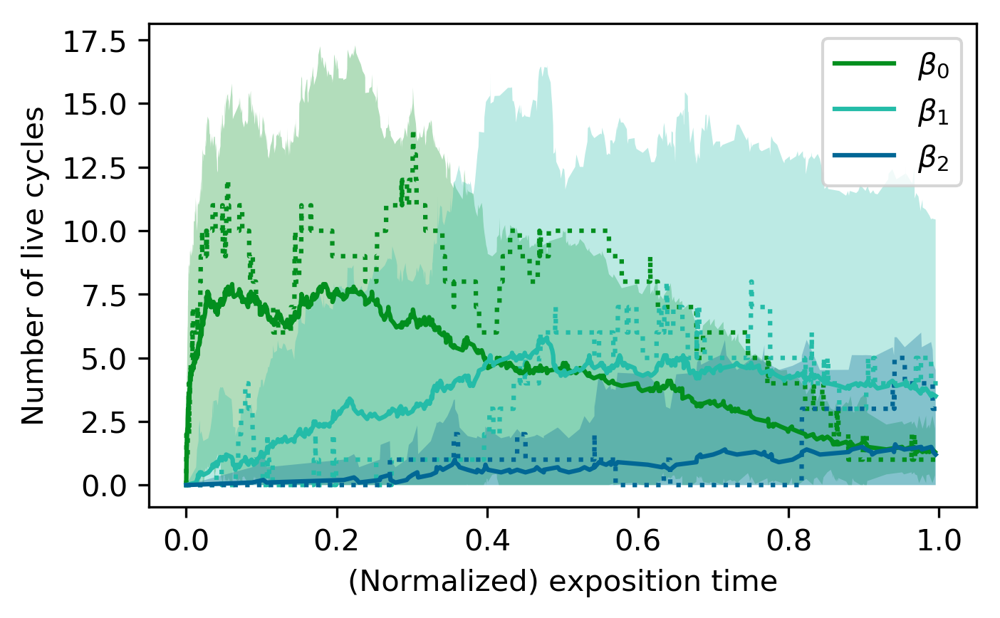

In [316]:
plt.figure(figsize=(5, 3), dpi=300)

strang_bettis = betti_curves(sent_bars[9], text_lens[9])
plt.plot(np.linspace(0, 1, strang_bettis.shape[1]), strang_bettis[0], 
         color='xkcd:emerald green', linestyle=':')
plt.plot(np.linspace(0, 1, strang_bettis.shape[1]), strang_bettis[1], 
         color='xkcd:tealish', linestyle=':')
plt.plot(np.linspace(0, 1, strang_bettis.shape[1]), strang_bettis[2], 
         color='xkcd:peacock blue', linestyle=':')
plot_bettis([betti_curves(sent_bars[i], text_lens[i])
                for i in range(10)])
plt.savefig('figures/alltexts_bettis.pdf', transparent=True, bbox_inches='tight')

Ok: let's try to figure out representative cycles.

In [4]:
from cyclonysus import Cycler

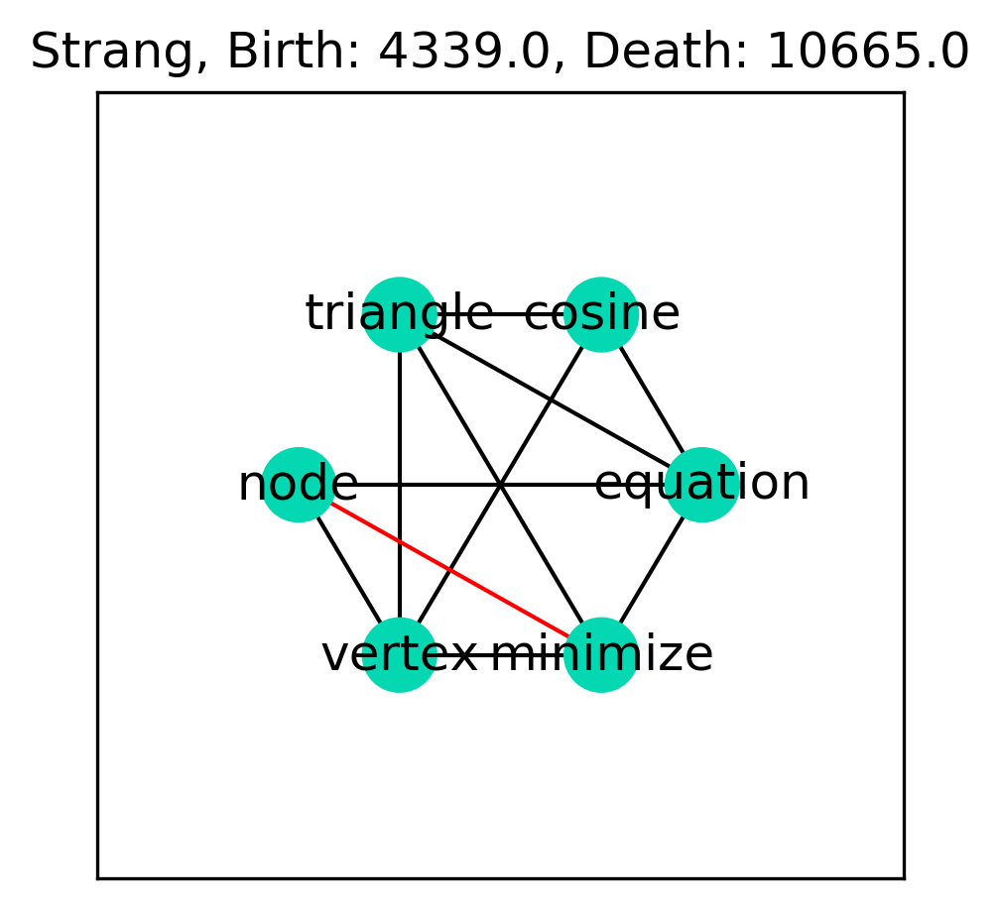

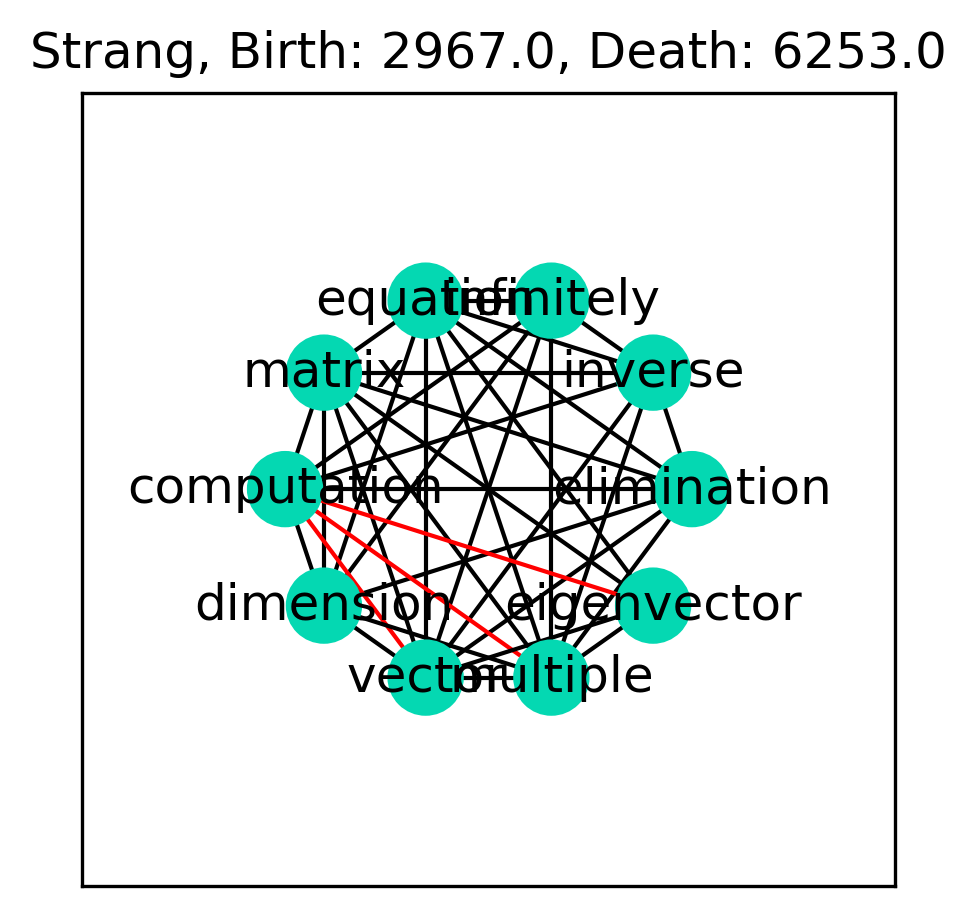

In [22]:
for j in range(9, 10):
    for i in range(1, 3):
        plt.figure(figsize=(3.5, 3.5), dpi=300)
        #print(texts[j])
        new_filt = sent_filts[j].copy()
        np.fill_diagonal(new_filt, 0)
        sq_dist = squareform(new_filt)
        sq_dist[sq_dist == np.inf] = text_lens[j]+1
        f = d.fill_rips(sq_dist, 3, text_lens[j])

        cycler = Cycler(order=i)
        cycler.from_simplices(simplices=f)
        # top 3 intervals
        top_intervals = cycler.longest_intervals(1)
        try:
            cycles = [cycler.get_cycle(interval) for interval in top_intervals]
        #     print(cycles)
            vertex_sets = [list(set().union(*c)) for c in cycles]
        #     print(vertex_sets)
            diagram = top_intervals[0]

            impt_verts = np.array(list(set(vertex_sets[0])))
        #         print(sent_filts[j][impt_verts, :][:, impt_verts])
            additional = list(zip(*np.where(sent_filts[j] == diagram.death)))
            additional = [a for a in additional if a[0] in impt_verts or a[1] in impt_verts]
            new_nodes = set().union(*additional)
            new_nodes = new_nodes.difference(impt_verts)
            impt_verts = list(impt_verts) + list(new_nodes)
            name_dict = dict(enumerate(labels[j][impt_verts]))
        #         print(name_dict)
            sub = sent_filts[j][impt_verts, :][:, impt_verts]
            np.fill_diagonal(sub, 0)
            #killing edge(s):
            death_edge = list(zip(*np.where(sub == diagram.death)))
            death_edge_set = set([tuple(sorted(x)) for x in death_edge])
            sub[sub >= diagram.death] = 0
            G = nx.from_numpy_array(sub)
            G.add_edges_from(death_edge_set)
            node_colors = ['xkcd:aquamarine' for _ in range(len(impt_verts))]
            #node_colors += ['red' for _ in range(len(new_nodes))]
            edge_colors = ['red' if (e[0], e[1]) in death_edge else 'black'
                                                 for e in 
                                                 G.edges()]
    #         print(diagram, text_lens[j])
    #         print(death_edge)
    #         print(sub)
            pos = nx.circular_layout(G)
            nx.draw_networkx(G, pos=pos, edge_color=edge_colors, 
                             node_color=node_colors, with_labels=False)

            new_pos = {name_dict[k]: v for k, v in pos.items()}
            nx.relabel_nodes(G, 
                         dict(enumerate(labels[j][impt_verts])),
                         copy=False)
            nx.draw_networkx_labels(G, pos=new_pos, font_color='black')
            plt.xlim([-2, 2])
            plt.ylim([-2, 2])
            plt.title('{}, Birth: {}, Death: {}'.format(texts[j],
                                                diagram.birth,
                                                diagram.death))
        except:
            pass
        plt.savefig('figures/strang_{}cycle.pdf'.format(i), transparent=True, bbox_inches='tight')
        plt.show()

In [23]:
import dionysus as d
from scipy.spatial.distance import squareform
# set diagonal to zero
j = 9
new_filt = sent_filts[j].copy()
np.fill_diagonal(new_filt, 0)
sq_dist = squareform(new_filt)
sq_dist[sq_dist == np.inf] = text_lens[j]+1
f = d.fill_rips(sq_dist, 3, text_lens[j])



In [24]:
cycler = Cycler(order=2)
cycler.from_simplices(simplices=f)

In [25]:
cycler.longest_intervals(1)


[(2967,6253)]

/usr/local/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):
/usr/local/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:585: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  and cb.iterable(edge_color) \


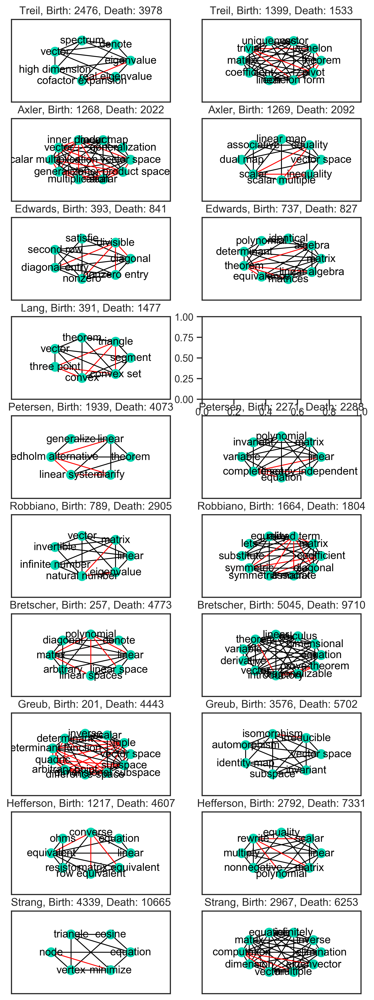

In [260]:
import dionysus as d
from scipy.spatial.distance import squareform
from cyclonysus import Cycler
labels = load_index_labels()
plt.figure(figsize=(7, 20), dpi=300)
for j in range(10):
    for i in range(1, 3):
        #print(texts[j])
        plt.subplot(10, 2, 2*j+i)
        new_filt = sent_filts[j].copy()
        np.fill_diagonal(new_filt, 0)
        sq_dist = squareform(new_filt)
        sq_dist[sq_dist == np.inf] = text_lens[j]+1
        f = d.fill_rips(sq_dist, 3, text_lens[j])

        cycler = Cycler(order=i)
        cycler.from_simplices(simplices=f)
        # top 3 intervals
        top_intervals = cycler.longest_intervals(1)
        try:
            cycles = [cycler.get_cycle(interval) for interval in top_intervals]
        #     print(cycles)
            vertex_sets = [list(set().union(*c)) for c in cycles]
        #     print(vertex_sets)
            diagram = top_intervals[0]

            impt_verts = np.array(list(set(vertex_sets[0])))
        #         print(sent_filts[j][impt_verts, :][:, impt_verts])
            additional = list(zip(*np.where(sent_filts[j] == diagram.death)))
            additional = [a for a in additional if a[0] in impt_verts or a[1] in impt_verts]
            new_nodes = set().union(*additional)
            new_nodes = new_nodes.difference(impt_verts)
            impt_verts = list(impt_verts) + list(new_nodes)
            name_dict = dict(enumerate(labels[j][impt_verts]))
        #         print(name_dict)
            sub = sent_filts[j][impt_verts, :][:, impt_verts]
            np.fill_diagonal(sub, 0)
            #killing edge(s):
            death_edge = list(zip(*np.where(sub == diagram.death)))
            death_edge_set = set([tuple(sorted(x)) for x in death_edge])
            sub[sub >= diagram.death] = 0
            G = nx.from_numpy_array(sub)
            G.add_edges_from(death_edge_set)
            node_colors = ['xkcd:aquamarine' for _ in range(len(impt_verts))]
            #node_colors += ['red' for _ in range(len(new_nodes))]
            edge_colors = ['red' if (e[0], e[1]) in death_edge else 'black'
                                                 for e in 
                                                 G.edges()]
    #         print(diagram, text_lens[j])
    #         print(death_edge)
    #         print(sub)
            pos = nx.circular_layout(G)
            nx.draw_networkx(G, pos=pos, edge_color=edge_colors, 
                             node_color=node_colors, with_labels=False, node_size=100)

            new_pos = {name_dict[k]: v for k, v in pos.items()}
            nx.relabel_nodes(G, 
                         dict(enumerate(labels[j][impt_verts])),
                         copy=False)
            nx.draw_networkx_labels(G, pos=new_pos, font_color='black')
            plt.xlim([-2, 2])
            plt.ylim([-2, 2])
            plt.title('{}, Birth: {}, Death: {}'.format(plottexts[j],
                                                int(diagram.birth),
                                                int(diagram.death)))
        except:
            pass
plt.savefig('figures/lots_of_cycles.pdf', transparent=True, bbox_inches='tight')
plt.show()

Okie doke - we'll explore this a bit more later, once we have a better sense of what we want to do about the representative cycles.

# RESULTS PART 4

Now, we just gotta compare persistent homology across each of the null models.
Start by loading all the oaat and null models data:

In [4]:
r_ind_sent_bars = load_r_ind_sent_bars()
r_sentord_sent_bars = load_r_sentord_sent_bars()


oaat_bars = load_oaat_bars()
r_ind_oaat_bars = load_r_ind_oaat_bars()
r_sentord_oaat_bars = load_r_sentord_oaat_bars()
rand_edge_bars = load_rand_edge_bars()
node_ord_bars = load_node_ord_bars()
#topo_dist_bars = load_topo_dist_bars()

In [5]:
all_bars = [sent_bars, r_ind_sent_bars, r_sentord_sent_bars]

all_oaat_bars = [oaat_bars, r_ind_oaat_bars, r_sentord_oaat_bars, rand_edge_bars, 
            node_ord_bars]# , topo_dist_bars]

In [8]:
all_bars[-1]

[array([[2027,
         list([(0, array([[2.000e+00, 4.000e+00],
        [3.000e+00, 5.000e+00],
        [9.000e+00, 1.000e+01],
        [1.200e+01, 1.300e+01],
        [1.700e+01, 1.800e+01],
        [1.600e+01, 1.900e+01],
        [2.200e+01, 2.300e+01],
        [2.600e+01, 2.800e+01],
        [2.500e+01, 2.900e+01],
        [2.700e+01, 3.000e+01],
        [2.400e+01, 3.100e+01],
        [1.500e+01, 3.200e+01],
        [1.100e+01, 4.400e+01],
        [4.800e+01, 5.000e+01],
        [4.900e+01, 5.100e+01],
        [5.600e+01, 5.800e+01],
        [5.700e+01, 5.900e+01],
        [6.200e+01, 6.400e+01],
        [6.300e+01, 6.500e+01],
        [6.800e+01, 6.900e+01],
        [7.000e+01, 7.100e+01],
        [7.300e+01, 7.400e+01],
        [7.600e+01, 7.700e+01],
        [7.900e+01, 8.000e+01],
        [7.800e+01, 8.100e+01],
        [8.300e+01, 8.400e+01],
        [8.500e+01, 8.700e+01],
        [8.600e+01, 8.800e+01],
        [9.000e+01, 9.100e+01],
        [9.200e+01, 9.300e+01],
       

We plot all the barcodes and bettis (actual text & nulls) for Treil

In [326]:
all_oaat_bars[0][0]

array([[3832,
        list([(0, array([[5.000e+00, 8.000e+00],
       [3.000e+00, 9.000e+00],
       [7.000e+00, 1.000e+01],
       [6.000e+00, 1.100e+01],
       [4.000e+00, 1.200e+01],
       [2.300e+01, 2.500e+01],
       [2.400e+01, 2.600e+01],
       [3.300e+01, 3.500e+01],
       [3.400e+01, 3.600e+01],
       [4.200e+01, 4.300e+01],
       [4.400e+01, 4.500e+01],
       [5.500e+01, 5.700e+01],
       [5.600e+01, 5.800e+01],
       [5.400e+01, 6.700e+01],
       [7.000e+01, 7.100e+01],
       [7.400e+01, 7.500e+01],
       [3.200e+01, 8.300e+01],
       [2.000e+00, 8.900e+01],
       [9.300e+01, 9.400e+01],
       [9.200e+01, 9.600e+01],
       [1.010e+02, 1.020e+02],
       [1.000e+02, 1.040e+02],
       [1.070e+02, 1.080e+02],
       [1.090e+02, 1.100e+02],
       [1.140e+02, 1.160e+02],
       [1.130e+02, 1.170e+02],
       [1.120e+02, 1.190e+02],
       [1.150e+02, 1.230e+02],
       [1.420e+02, 1.430e+02],
       [1.520e+02, 1.530e+02],
       [1.550e+02, 1.560e+02],
       

In [330]:
list(map(tuple, all_bars[0][0]))

[(0, array([[3.400e+01, 3.600e+01],
         [2.100e+01, 6.500e+01],
         [2.000e+00, 6.900e+01],
         [7.000e+01, 7.500e+01],
         [3.040e+02, 3.050e+02],
         [1.510e+02, 3.770e+02],
         [3.710e+02, 3.910e+02],
         [4.820e+02, 5.340e+02],
         [5.520e+02, 5.590e+02],
         [5.860e+02, 6.050e+02],
         [1.900e+02, 6.060e+02],
         [6.650e+02, 6.680e+02],
         [1.350e+02, 7.140e+02],
         [6.110e+02, 7.320e+02],
         [7.820e+02, 7.830e+02],
         [3.920e+02, 8.350e+02],
         [8.420e+02, 8.460e+02],
         [9.800e+02, 9.940e+02],
         [1.023e+03, 1.027e+03],
         [7.300e+01, 1.070e+03],
         [2.810e+02, 1.074e+03],
         [1.287e+03, 1.297e+03],
         [1.213e+03, 1.382e+03],
         [1.388e+03, 1.391e+03],
         [1.622e+03, 1.757e+03],
         [5.690e+02, 1.836e+03],
         [2.156e+03, 2.167e+03],
         [9.510e+02, 2.184e+03],
         [2.244e+03, 2.245e+03],
         [1.793e+03, 2.301e+03],
       

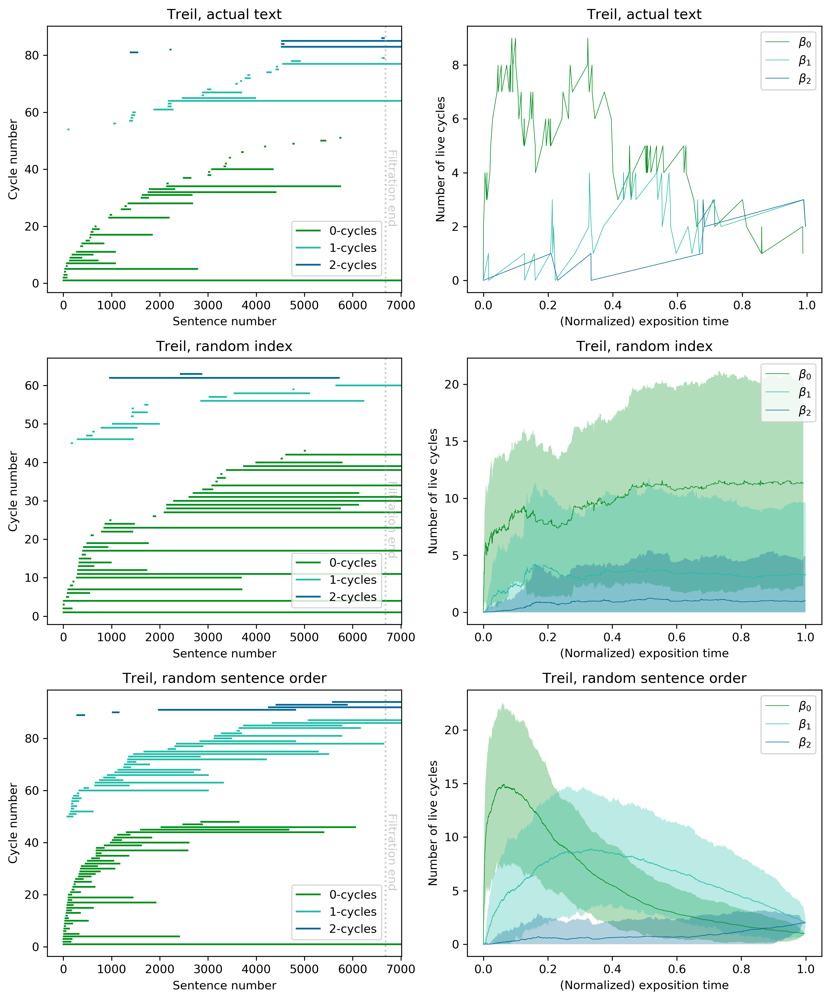

In [6]:
plt.figure(figsize=(10, 12), dpi=300)
i = 0

plottexts = ['Treil', 'Axler', 'Edwards', 'Lang', 'Petersen', 'Robbiano',
             'Bretscher', 'Greub', 'Hefferson', 'Strang']
modelnames = ['actual text', 'random index', 'random sentence order']#, 'topological distance']

for j in tqdm_notebook(range(len(all_bars))):
    now_bar = all_bars[j]
    plt.subplot(3, 2, 2*j+1)
    plt.title('{}, {}'.format(plottexts[i], modelnames[j]))
    if modelnames[j] == 'actual text':
        plot_barcode(list(map(tuple, now_bar[i])), text_lens[i])
    else:
        plot_barcode(list(map(tuple, now_bar[i][0])), text_lens[i])
    plt.subplot(3, 2, 2*j+2)
    plt.title('{}, {}'.format(plottexts[i], modelnames[j]))
    if modelnames[j] == 'actual text':
        all_bettis = [betti_curves(list(map(tuple, now_bar[i])), text_lens[i])]
    else:
        all_bettis = [betti_curves(list(map(tuple, now_bar[i][k])), text_lens[i])
                  for k in range(100)]
    plot_bettis(all_bettis)
plt.tight_layout()
plt.savefig('figures/ph_nulls_treil_sent.pdf', transparent=True, bbox_inches='tight')

plt.show()

And then for every single one of the texts, using the oaat filtrations

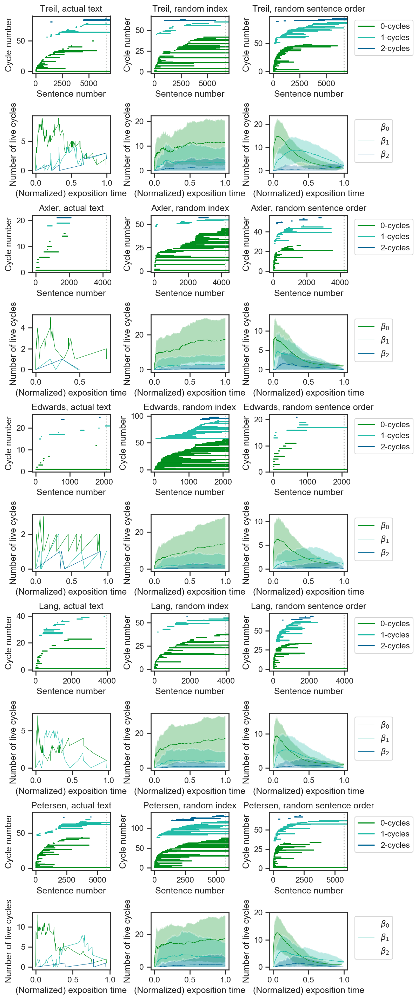

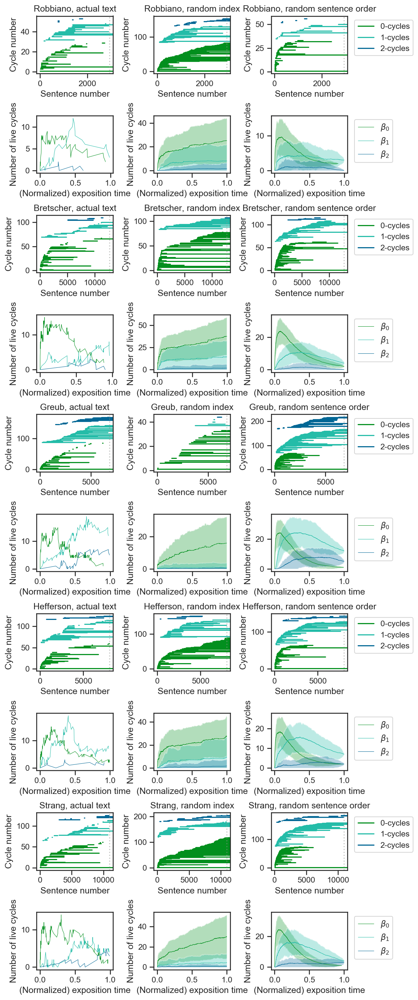

In [8]:
modelnames = ['actual text', 'random index', 'random sentence order']
plt.figure(figsize=(8, 19), dpi=150)
from matplotlib import font_manager 
import matplotlib
matplotlib.rcParams.update({'font.size': 8})
plt.rc('font', family='sans-serif') 
plt.rc('font', serif='Helvetica') 
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plottexts = ['Treil', 'Axler', 'Edwards', 'Lang', 'Petersen', 'Robbiano',
             'Bretscher', 'Greub', 'Hefferson', 'Strang']
modelnames = ['actual text', 'random index', 'random sentence order']
for i in tqdm_notebook(range(5)):
    for j in range(len(all_bars)):
        now_bar = all_bars[j]
        plt.subplot(10, 3, 6*i+j+1)
        plt.title('{}, {}'.format(plottexts[i], modelnames[j]))
        if modelnames[j] == 'actual text':
            plot_barcode(list(map(tuple, now_bar[i])), text_lens[i], end=False)
        else:
            plot_barcode(list(map(tuple, now_bar[i][0])), text_lens[i], end=False)
        if j == 2:
            plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
        plt.subplot(10, 3, 6*i+j+4)
        if modelnames[j] == 'actual text':
            all_bettis = [betti_curves(list(map(tuple, now_bar[i])), text_lens[i])]
        else:
            all_bettis = [betti_curves(list(map(tuple, now_bar[i][k])), text_lens[i])
                      for k in range(100)]
        plot_bettis(all_bettis)
        if j == 2:
            plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
plt.tight_layout()
plt.savefig('figures/ph_sent_nulls_all_1.png', transparent=True, bbox_inches='tight')
plt.show()
plt.figure(figsize=(8, 19), dpi=150)
for i in tqdm_notebook(range(5, 10)):
    for j in range(len(all_bars)):
        now_bar = all_bars[j]
        plt.subplot(10, 3, 6*(i-5)+j+1)
        plt.title('{}, {}'.format(plottexts[i], modelnames[j]))
        if modelnames[j] == 'actual text':
            plot_barcode(list(map(tuple, now_bar[i])), text_lens[i], end=False)
        else:
            plot_barcode(list(map(tuple, now_bar[i][0])), text_lens[i], end=False)
        if j == 2:
            plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
        plt.subplot(10, 3, 6*(i-5)+j+4)
        if modelnames[j] == 'actual text':
            all_bettis = [betti_curves(list(map(tuple, now_bar[i])), text_lens[i])]
        else:
            all_bettis = [betti_curves(list(map(tuple, now_bar[i][k])), text_lens[i])
                      for k in range(100)]
        plot_bettis(all_bettis)
        if j == 2:
            plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")

    
plt.tight_layout()
plt.savefig('figures/ph_sent_nulls_all_2.png', transparent=True, bbox_inches='tight')
plt.show()

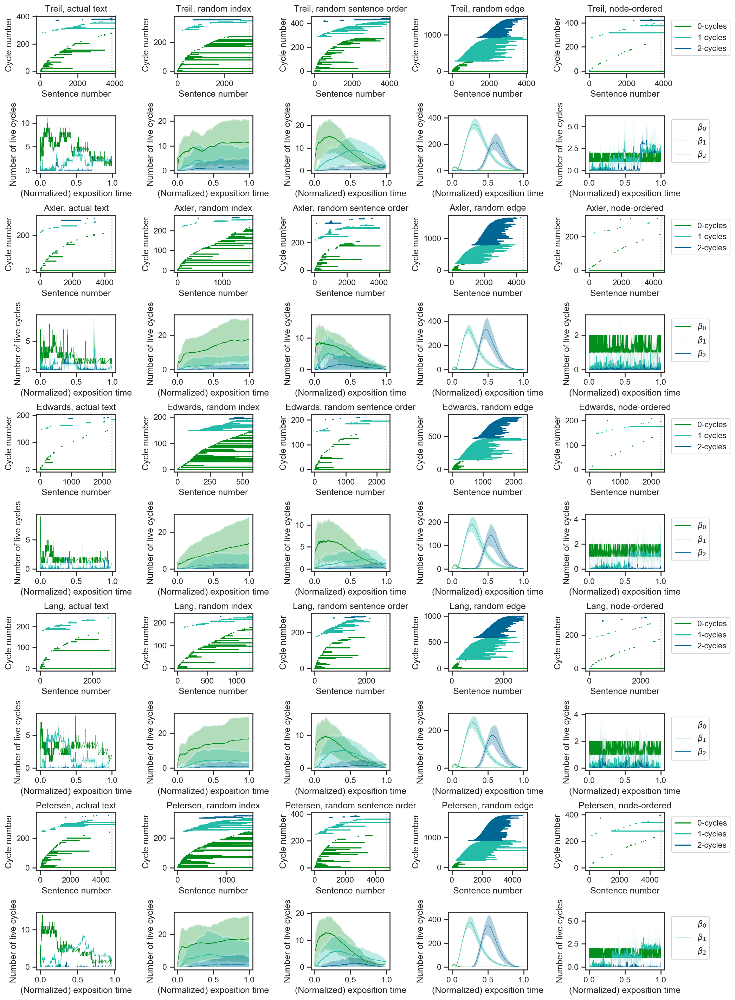

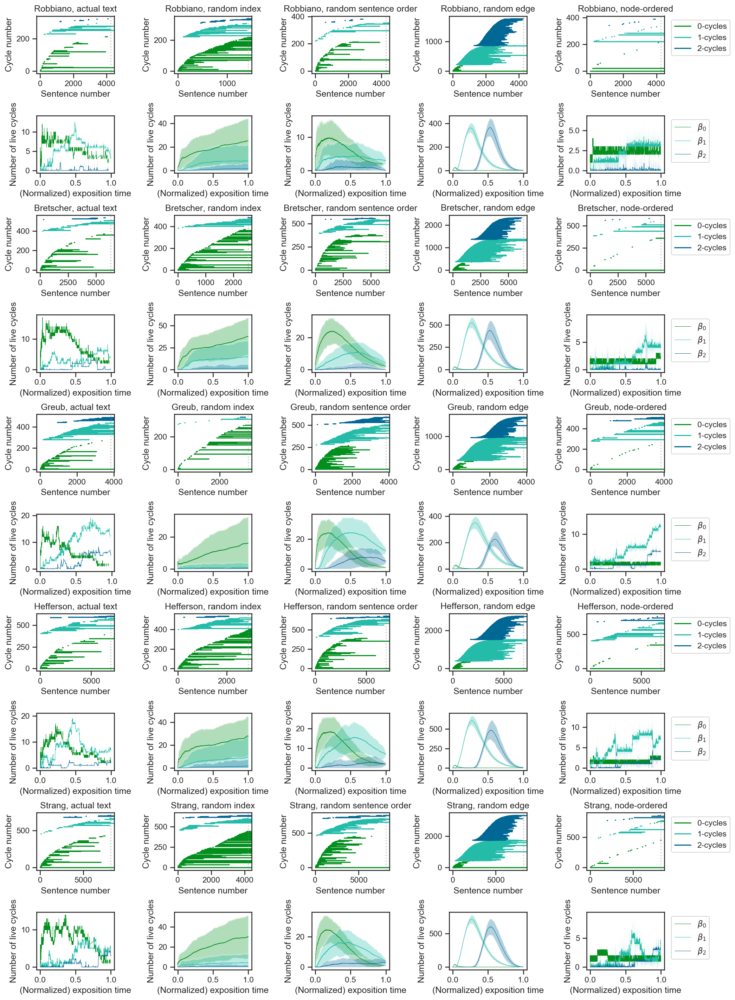

In [9]:
modelnames = ['actual text', 'random index', 'random sentence order', 'random edge', 'node-ordered']
matplotlib.rcParams.update({'font.size': 8})
plt.rc('font', family='sans-serif') 
plt.rc('font', serif='Helvetica') 
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.figure(figsize=(14, 19), dpi=150)
for i in tqdm_notebook(range(5)):
    for j in range(len(all_oaat_bars)):
        now_bar = all_oaat_bars[j]
        plt.subplot(10, 5, 10*i+j+1)
        plt.title('{}, {}'.format(plottexts[i], modelnames[j]))
        plot_barcode(now_bar[i][0][1], now_bar[i][0][0], end=False)
        if j == 4:
            plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
        plt.subplot(10, 5, 10*i+j+6)
        all_bettis = [betti_curves(now_bar[i][j][1], now_bar[i][j][0])
                      for j in range(100)]
        plot_bettis(all_bettis)
        if j == 4:
            plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
plt.tight_layout()
plt.savefig('figures/ph_nulls_all_1.png', transparent=True, bbox_inches='tight')
plt.show()
plt.figure(figsize=(14, 19), dpi=150)
for i in tqdm_notebook(range(5,10)):
    for j in range(len(all_oaat_bars)):
        now_bar = all_oaat_bars[j]
        plt.subplot(10, 5, 10*(i-5)+j+1)
        plt.title('{}, {}'.format(plottexts[i], modelnames[j]))
        plot_barcode(now_bar[i][0][1], now_bar[i][0][0], end=False)
        if j == 4:
            plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
        plt.subplot(10, 5, 10*(i-5)+j+6)
        all_bettis = [betti_curves(now_bar[i][j][1], now_bar[i][j][0])
                      for j in range(100)]
        plot_bettis(all_bettis)
        if j == 4:
            plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
plt.tight_layout()
plt.savefig('figures/ph_nulls_all_2.png', transparent=True, bbox_inches='tight')
plt.show()

Now let's do some fun stuff with the barcode density.

First we compute all the densities and other associated information.

In [10]:
true_oaat_density = np.zeros((10, 100, 4, 3))
for i in range(10):
    reses = []
    for j in range(100):
        reses.append(barcode_density(oaat_bars[i][j][1], 
                                     oaat_bars[i][j][0]))
    reses = np.stack(reses)
    true_oaat_density[i] = reses
    
true_sent_density = np.zeros((10, 4, 3))
for i in range(10):
    res = barcode_density(sent_bars[i], text_lens[i])
    true_sent_density[i] = res
    
r_ind_sent_density = np.zeros((10, 100, 4, 3))
for i in range(10):
    reses = []
    for j in range(100):
        reses.append(barcode_density(r_ind_sent_bars[i][j], 
                                     text_lens[i]))
    reses = np.stack(reses)
    r_ind_sent_density[i] = reses
    
r_ind_oaat_density = np.zeros((10, 100, 4, 3))
for i in range(10):
    reses = []
    for j in range(100):
        reses.append(barcode_density(r_ind_oaat_bars[i][j][1], 
                                     r_ind_oaat_bars[i][j][0]))
    reses = np.stack(reses)
    r_ind_oaat_density[i] = reses
    
r_sentord_sent_density = np.zeros((10, 100, 4, 3))
for i in range(10):
    reses = []
    for j in range(100):
        reses.append(barcode_density(r_sentord_sent_bars[i][j], 
                                     text_lens[i]))
    reses = np.stack(reses)
    r_sentord_sent_density[i] = reses
    
r_sentord_oaat_density = np.zeros((10, 100, 4, 3))
for i in range(10):
    reses = []
    for j in range(100):
        reses.append(barcode_density(r_sentord_oaat_bars[i][j][1], 
                                     r_sentord_oaat_bars[i][j][0]))
    reses = np.stack(reses)
    r_sentord_oaat_density[i] = reses
    
rand_edge_density = np.zeros((10, 100, 4, 3))
for i in range(10):
    reses = []
    for j in range(100):
        reses.append(barcode_density(rand_edge_bars[i][j][1], 
                                     rand_edge_bars[i][j][0]))
    reses = np.stack(reses)
    rand_edge_density[i] = reses

node_ord_density = np.zeros((10, 100, 4, 3))
for i in range(10):
    reses = []
    for j in range(100):
        reses.append(barcode_density(node_ord_bars[i][j][1], 
                                     node_ord_bars[i][j][0]))
    reses = np.stack(reses)
    node_ord_density[i] = reses
    
# topo_dist_density = np.zeros((10, 100, 4, 3))
# for i in range(10):
#     reses = []
#     for j in range(100):
#         reses.append(barcode_density(topo_dist_bars[i][j][1], 
#                                      topo_dist_bars[i][j][0]))
#     reses = np.stack(reses)
#     topo_dist_density[i] = reses

/Users/nicochristianson/Desktop/Bassett Work/Work/Analysis.py:520: RuntimeWarning: invalid value encountered in true_divide
  normed_density = densities/nums


In [342]:
r_sentord_sent_density

array([[[[7.75332811e+00, 6.16758027e+00, 8.26416079e-01],
         [2.78000000e+02, 1.37000000e+02, 2.30000000e+01],
         [2.78896695e-02, 4.50188341e-02, 3.59311339e-02],
         [1.00000000e+00, 2.00000000e+00, 2.00000000e+00]],

        [[7.25841817e+00, 5.23414252e+00, 3.34377447e-01],
         [2.78000000e+02, 1.21000000e+02, 1.40000000e+01],
         [2.61094179e-02, 4.32573762e-02, 2.38841034e-02],
         [1.00000000e+00, 2.00000000e+00, 2.00000000e+00]],

        [[9.97859567e+00, 5.65544244e+00, 6.97206996e-01],
         [2.78000000e+02, 1.31000000e+02, 1.90000000e+01],
         [3.58942290e-02, 4.31713164e-02, 3.66951050e-02],
         [1.00000000e+00, 2.00000000e+00, 2.00000000e+00]],

        ...,

        [[8.36100235e+00, 5.54607152e+00, 3.26807622e-01],
         [2.78000000e+02, 1.26000000e+02, 1.60000000e+01],
         [3.00755480e-02, 4.40164406e-02, 2.04254764e-02],
         [1.00000000e+00, 2.00000000e+00, 2.00000000e+00]],

        [[7.04829026e+00, 5.436178

Now, we do a violinplot for the normed barcode density (we're gonna call this density from now on) on just the random index and sentence order nulls

In [42]:
import pandas as pd
plottexts = ['Treil', 'Axler', 'Edwards', 'Lang', 'Petersen', 'Robbiano',
             'Bretscher', 'Greub', 'Hefferson', 'Strang']
models = [r_ind_sent_density, r_sentord_sent_density]
model_names = ['Random index', 'Random sentence order']
big_df = []
for m in range(len(models)):
    for i in range(10):
        for d in range(3):
            df = pd.DataFrame({'Barcode Density': models[m][i, :, 2, d],
                               'Text': plottexts[i],
                               'Model': model_names[m],
                               'dimension': d})
            big_df.append(df)
big_df = pd.concat(big_df)

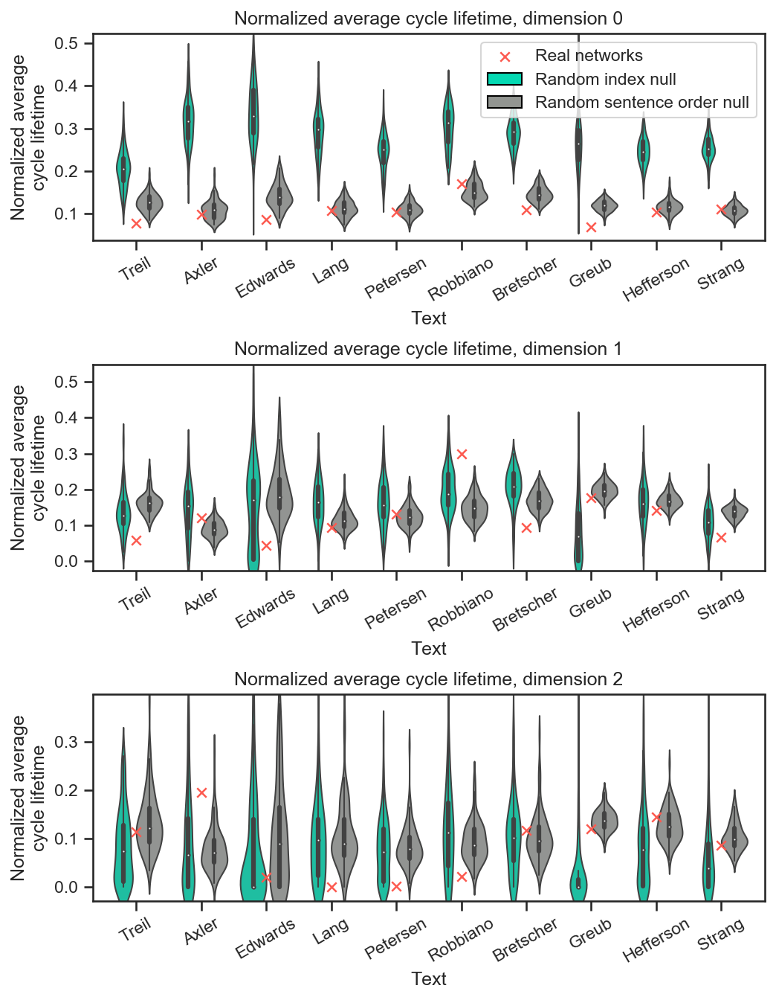

In [43]:
from matplotlib.patches import Patch
colors = ['xkcd:aquamarine', 'xkcd:grey']
plt.figure(figsize=(7, 9), dpi=150)
for d in range(3):
    plt.subplot(3,1, d+1)
    #plt.yscale('log')
    dim_df = big_df.loc[big_df['dimension'] == d]
    sns.violinplot(x='Text', y='Barcode Density', hue='Model', data=dim_df, 
                  dodge=True, palette=colors, zorder=2, linewidth=1)
    sns.scatterplot(plottexts, true_sent_density[:, 2, d], color='xkcd:coral', 
                marker='x', linewidth=1.2, zorder=20)
    plt.title('Normalized average cycle lifetime, dimension {}'.format(d))
    if d == 0:
        plt.legend([plt.scatter([],[], marker='x', color='xkcd:coral',
                            linewidth=1.2), 
                Patch(facecolor='xkcd:aquamarine', edgecolor='xkcd:black', 
                      linewidth=1, linestyle='-', fill=True), 
                Patch(facecolor='xkcd:grey', edgecolor='xkcd:black', 
                      linewidth=1, linestyle='-', fill=True)],
               ['Real networks', 'Random index null', 
                'Random sentence order null'],
              loc='upper right')
    else:
        plt.gca().get_legend().remove()
    plt.ylabel('Normalized average\ncycle lifetime')
    plt.xticks(range(10), plottexts, rotation=30)
plt.tight_layout()
plt.savefig('figures/barcode_density.png', 
            transparent=True, bbox_inches='tight')

plt.show()

And for all the null models

In [358]:
true_oaat_density

array([[[[0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.]],

        [[0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.]],

        [[0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.]],

        ...,

        [[0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.]],

        [[0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.]],

        [[0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.]]],


       [[[0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.]],

        [[0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.]],

        [[0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.]],

        ...,

        [[0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.]],

        [[0., 0., 0.],
       

In [44]:
import pandas as pd
plottexts = ['Treil', 'Axler', 'Edwards', 'Lang', 'Petersen', 'Robbiano',
             'Bretscher', 'Greub', 'Hefferson', 'Strang']
models = [true_oaat_density, r_ind_oaat_density, r_sentord_oaat_density, 
          rand_edge_density,node_ord_density]
model_names = ['Actual networks', 'Random index', 'Random Sentence Order',
               'Random edge', 'Node-ordered']
big_df = []
for m in range(len(models)):
    for i in range(10):
        for d in range(3):
            df = pd.DataFrame({'Barcode Density': models[m][i, :, 2, d],
                               'Text': plottexts[i],
                               'Model': model_names[m],
                               'dimension': d})
            big_df.append(df)
big_df = pd.concat(big_df)

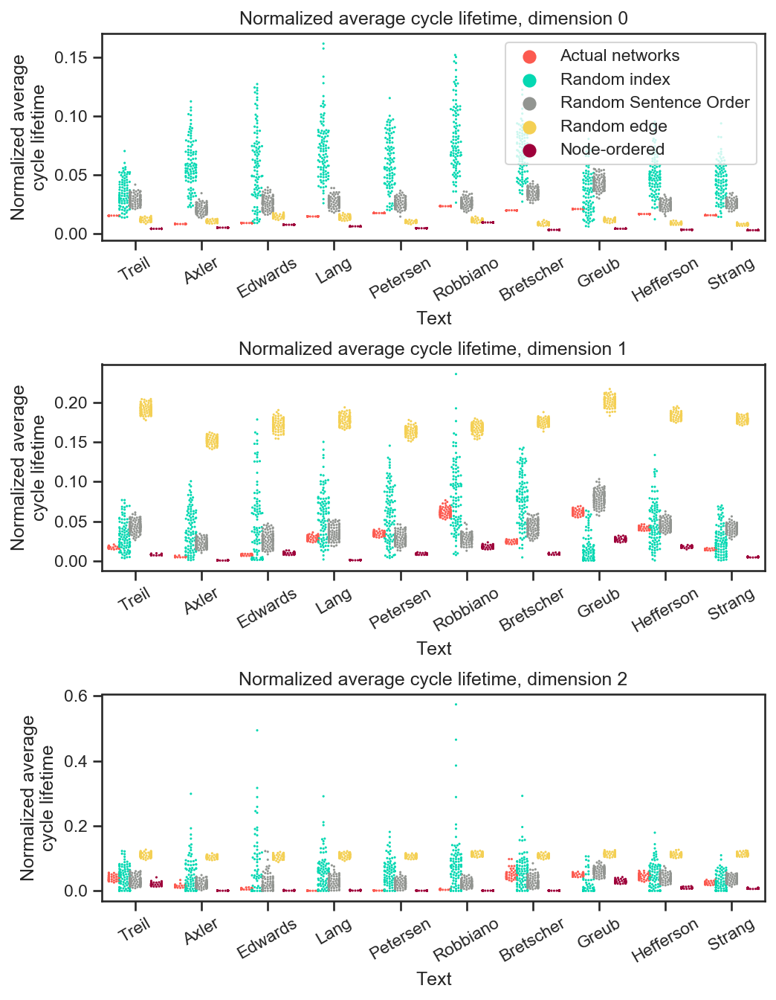

In [47]:
colors = ['xkcd:coral', 'xkcd:aquamarine', 'xkcd:grey', 
          'xkcd:maize', 'xkcd:cranberry']
plt.figure(figsize=(7, 9), dpi=150)
for d in range(3):
    plt.subplot(3, 1, d+1)
    #plt.yscale('log')
    dim_df = big_df.loc[big_df['dimension'] == d]
    sns.swarmplot(x='Text', y='Barcode Density', hue='Model', data=dim_df, 
                  size=1.5, dodge=True, palette=colors, zorder=2)
#     sns.boxplot(x='text', y='density', hue='model', 
#                 data=dim_df, color='black', zorder=1)
    plt.title('Normalized average cycle lifetime, dimension {}'.format(d))
    plt.ylabel('Normalized average\ncycle lifetime')
    plt.xticks(range(10), plottexts, rotation=30)
    plt.legend(loc='upper right')
    if d != 0:
        plt.gca().get_legend().remove()
    
plt.tight_layout()
plt.savefig('figures/barcode_density_supp.png'.format(d), 
            transparent=True, bbox_inches='tight')

plt.show()

In [48]:
sent_coocs = load_sent_coocs()
sent_lens = load_n_sents()

Now, we'll draw our various correlations

In [200]:
true_qc / m_r_ind_qc

array([0.78797765, 0.72774771, 0.76113023, 0.76118528, 0.87462348,
       0.71698533, 0.8138448 , 0.68666352, 0.76429501, 0.74344439])

In [49]:
sent_filts = load_sent_filts()

In [50]:
from bct import core_periphery_dir, community_louvain

true_cms = load_sent_coocs()

true_C, true_qc = [], []
true_M, true_qm = [], []
for true_cm in tqdm_notebook(true_cms):
    C, qc = core_periphery_dir(true_cm)
    true_C.append(C)
    true_qc.append(qc)
    # get the periphery indices only
    P = np.array(1 - C, dtype=bool) 
    M, qm = community_louvain(true_cm[P, :][:, P])
    true_M.append(M)
    true_qm.append(qm)
    
r_ind_C = load_r_ind_C()
r_ind_qc = load_r_ind_qc()
r_ind_M = load_r_ind_M()
r_ind_qm = load_r_ind_qm()

r_sentord_C = load_r_sentord_C()
r_sentord_qc = load_r_sentord_qc()
r_sentord_M = load_r_sentord_M()
r_sentord_qm = load_r_sentord_qm()

cont_config_qc = load_cont_config_qc()
cont_config_qm = load_cont_config_qm()


m_r_ind_qc = np.mean(r_ind_qc, axis=1)
m_r_sentord_qc = np.mean(r_sentord_qc, axis=1)
m_cont_config_qc = np.mean(cont_config_qc, axis=1)

m_r_ind_qm = np.mean(r_ind_qm, axis=1)
m_r_sentord_qm = np.mean(r_sentord_qm, axis=1)
m_cont_config_qm = np.mean(cont_config_qm, axis=1)

true_diff_areas = []
for i in range(10):
    peris, cores = group_node_intro(sent_filts[i], 
                                    true_C[i], 
                                    sent_lens[i])
    true_diff_areas.append(normed_diff_area(cores, peris))
    
r_ind_filts = load_r_ind_filt_mats()
r_ind_diff_areas = []

for i in range(10):
    r_ind_diff_areas.append([])
    for j in range(100):
        peris, cores = np.array(group_node_intro(r_ind_filts[i][j],
                                                       r_ind_C[i][j],
                                                       sent_lens[i]))
        r_ind_diff_areas[i].append(normed_diff_area(cores, peris))
m_r_ind_diff_areas = np.mean(r_ind_diff_areas, axis=1)    
    
r_sentord_filts = load_r_sentord_filt_mats()
r_sentord_diff_areas = []

for i in range(10):
    r_sentord_diff_areas.append([])
    for j in range(100):
        peris, cores = np.array(group_node_intro(r_sentord_filts[i][j],
                                                       r_sentord_C[i][j],
                                                       sent_lens[i]))
        r_sentord_diff_areas[i].append(normed_diff_area(cores, peris))
m_r_sentord_diff_areas = np.mean(r_sentord_diff_areas, axis=1)  
        
true_comm_ks = []
for i in range(10):
    x = group_edge_intro(sent_filts[i], true_C[i], 
                         true_M[i], sent_lens[i])
    x = x[~np.any(np.isnan(x), axis=1)]
    xtest = x
    diff = xtest - np.linspace(0, 1, xtest.shape[1])
    max_magns = diff[np.arange(diff.shape[0]), 
                     np.argmax(np.abs(diff), axis=1)]
    true_comm_ks.append(np.mean(np.abs(max_magns[3:])))
    
r_ind_comm_ks = np.array([0.5118038691731763, 0.5568404881910347, 
                 0.6289870894631411, 0.6449300592053773, 
                 0.5786818885677911, 0.6550009960141654, 
                 0.6102316521931926, 0.5102684444928418, 
                 0.5986742067077634, 0.5926595767133365])
    
r_sentord_comm_ks = np.array([0.27005125660296075, 0.30391976734795895, 
                              0.23625010963811516, 0.30730669448757925, 
                              0.2705330764660125, 0.2537946069544722, 
                              0.2791268298031839, 0.23997582620198188, 
                              0.22427305632599462, 0.20160268919174587])


/Users/nicochristianson/Desktop/Bassett Work/Work/Analysis.py:405: RuntimeWarning: invalid value encountered in true_divide
  return (devs.T / np.max(devs, axis=1)).T


In [23]:
st.linregress(corr_df['nproof'], true_diff_areas - m_r_ind_diff_areas)

LinregressResult(slope=0.6611012576820074, intercept=-0.1772990817455541, rvalue=0.30048929432584925, pvalue=0.39888528853522953, stderr=0.7418986136773907)

In [51]:
sel_texts = np.array([0, 1, 3, 6, 7, 8, 9])
ratings = [3.83, 4.26, 4.23, 3.37, 3.43, 3.96, 4.21]
n_ratings = [6, 673, 31, 71, 7, 25, 891]

ratings_nan = [3.83, 4.26, np.nan, 4.23, np.nan, 
               np.nan, 3.37, 3.43, 3.96, 4.21]
n_ratings_nan = [6, 673, np.nan, 31, np.nan, 
                 np.nan, 71, 7, 25, 891]

In [ ]:
# Backup
# import pandas as pd
# plottexts = ['Treil', 'Axler', 'Edwards', 'Lang', 'Petersen', 'Robbiano',
#              'Bretscher', 'Greub', 'Hefferson', 'Strang']
# labels = load_index_labels()
# all_texts = load_text()
# num_det = count_occ('determinant', all_texts, text_lens)
# num_proof = count_occ('proof', all_texts, text_lens)
# num_system = count_occ('system', all_texts, text_lens)
# num_comp = count_occ('comput', all_texts, text_lens)
# num_calculat = count_occ('calculat', all_texts, text_lens)

# coocs = load_sent_coocs()
# edge_counts = []
# for cooc in coocs:
#     np.fill_diagonal(cooc, 0)
#     G = nx.from_numpy_array(cooc)
#     edge_counts.append(nx.density(G))
    
# avg_sent_density = (true_sent_density[:, 2, 0] + true_sent_density[:, 2, 1] + true_sent_density[:, 2, 2])/3
# avg_oaat_density = (np.mean(true_oaat_density, axis=1)[:, 2, 0]
#                     + np.mean(true_oaat_density, axis=1)[:, 2, 1]
#                     + np.mean(true_oaat_density, axis=1)[:, 2, 2])/3

# data = list(zip(plottexts,
#                 true_sent_density[:, 2, 0], true_sent_density[:, 2, 1], 
#                 true_sent_density[:, 2, 2], avg_sent_density,
#                 np.mean(true_oaat_density, axis=1)[:, 2, 0], np.mean(true_oaat_density, axis=1)[:, 2, 1], 
#                 np.mean(true_oaat_density, axis=1)[:, 2, 2], avg_oaat_density,
#                 true_qc, true_qm, true_diff_areas, true_comm_ks,
#                 num_det, num_proof, num_system, num_comp, num_calculat,
#                 ratings_nan, n_ratings_nan, 
#                 text_lens, [len(l) for l in labels], edge_counts))
# cols =  ['text', 
#          'sentndens0', 'sentndens1', 'sentndens2', 'avgsentdens',
#          'oaatndens0', 'oaatndens1', 'oaatndens2', 'avgoaatdens',
#          'Coreness', 'Modularity', 'diffarea', 'commks',
#          'ndet', 'nproof', 'nsystem', 'ncomp', 'ncalculat', 
#          'ratings', 'nratings',
#          'textlen', 'nodecount', 'edgedensity']
# corr_df = pd.DataFrame(data, columns=cols)
# corr_df

In [62]:
import pandas as pd
plottexts = ['Treil', 'Axler', 'Edwards', 'Lang', 'Petersen', 'Robbiano',
             'Bretscher', 'Greub', 'Hefferson', 'Strang']
labels = load_index_labels()
all_texts = load_text()
num_det = count_occ('determinant', all_texts, text_lens)
num_proof = count_occ('proof', all_texts, text_lens)
num_system = count_occ('system', all_texts, text_lens)
num_comp = count_occ('comput', all_texts, text_lens)
num_calculat = count_occ('calculat', all_texts, text_lens)

coocs = load_sent_coocs()
edge_counts = []
for cooc in coocs:
    np.fill_diagonal(cooc, 0)
    G = nx.from_numpy_array(cooc)
    edge_counts.append(nx.density(G))
    
avg_sent_density = (true_sent_density[:, 2, 0] + true_sent_density[:, 2, 1] + true_sent_density[:, 2, 2])/3
avg_oaat_density = (np.mean(true_oaat_density, axis=1)[:, 2, 0]
                    + np.mean(true_oaat_density, axis=1)[:, 2, 1]
                    + np.mean(true_oaat_density, axis=1)[:, 2, 2])/3

data = list(zip(true_sent_density[:, 2, 0], true_sent_density[:, 2, 1], 
                true_sent_density[:, 2, 2], avg_sent_density,
                np.mean(true_oaat_density, axis=1)[:, 2, 0], np.mean(true_oaat_density, axis=1)[:, 2, 1], 
                np.mean(true_oaat_density, axis=1)[:, 2, 2], avg_oaat_density,
                true_qc, true_qm, true_diff_areas, true_comm_ks,
                num_proof, num_comp,
                ratings_nan, n_ratings_nan, 
                text_lens, [len(l) for l in labels], edge_counts))
cols =  [
         'NACL 0', 'NACL 1', 'NACL 2', 'Avg. NACL',
         'OAAT NACL 0', 'OAAT NACL 1', 'OAAT NACL 2', 'Avg. OAAT NACL',
         'Core-ness', 'Modularity', 'Core - periph. area', 'Intra-comm. K-S',
         '"Proof" freq.', '"Comput-" freq.', 
         'Avg. rating', '# ratings',
         '# sentences', 'Node count', 'Edge density']
corr_df = pd.DataFrame(data, columns=cols)
corr_df

,NACL 0,NACL 1,NACL 2,Avg. NACL,OAAT NACL 0,OAAT NACL 1,OAAT NACL 2,Avg. OAAT NACL,Core-ness,Modularity,Core - periph. area,Intra-comm. K-S,"""Proof"" freq.","""Comput-"" freq.",Avg. rating,# ratings,# Sentences,Node count,Edge density
0,0.076989,0.057992,0.112600,0.082527,0.015097,0.017044,0.038710,0.023617,1.011434,0.664956,0.133617,0.493538,0.031432,0.023350,3.83,6.0,6681,278,0.092279
1,0.097713,0.121119,0.195070,0.137967,0.007948,0.005389,0.014438,0.009259,0.970327,0.571189,0.065294,0.490041,0.085545,0.013744,4.26,673.0,4220,217,0.180449
2,0.085118,0.042753,0.019532,0.049135,0.008835,0.007494,0.006181,0.007504,0.964041,0.513533,0.198165,0.426814,0.031462,0.020813,NaN,NaN,2066,146,0.204157
3,0.106267,0.094381,0.000000,0.066883,0.014363,0.028358,0.000776,0.014499,0.961720,0.540357,0.087080,0.446307,0.037393,0.009601,4.23,31.0,3958,179,0.162388
4,0.102189,0.131830,0.001524,0.078514,0.017237,0.034149,0.001196,0.017527,1.108460,0.467483,0.113573,0.424910,0.035354,0.012539,NaN,NaN,5742,244,0.150779
5,0.169309,0.298222,0.021577,0.163036,0.023088,0.061162,0.004718,0.029656,0.882530,0.482171,0.099772,0.429579,0.006114,0.004416,NaN,NaN,2944,219,0.169369
6,0.107406,0.093755,0.116268,0.105810,0.019600,0.024216,0.048326,0.030714,1.144580,0.609344,0.064007,0.446967,0.006298,0.011651,3.37,71.0,12703,384,0.081008
7,0.067836,0.175749,0.119713,0.121100,0.020726,0.061052,0.049684,0.043821,0.979329,0.637795,0.089299,0.450540,0.018711,0.001169,3.43,7.0,6841,275,0.094333
8,0.103089,0.141162,0.144111,0.129454,0.016444,0.041395,0.044235,0.034025,1.042669,0.616372,0.098994,0.374941,0.024360,0.021626,3.96,25.0,8046,399,0.082127
9,0.110394,0.066516,0.085254,0.087388,0.015394,0.014407,0.023962,0.017921,1.057003,0.580968,0.130980,0.456315,0.007570,0.024989,4.21,891.0,10965,453,0.075758


In [221]:
import statsmodels.api as sm
import statsmodels.formula.api as smf
results = smf.ols('ratings ~ oaatndens0 + nratings', data=corr_df.dropna()).fit()
print(results.summary())

                            OLS Regression Results                            
Dep. Variable:                ratings   R-squared:                       0.699
Model:                            OLS   Adj. R-squared:                  0.548
Method:                 Least Squares   F-statistic:                     4.636
Date:                Mon, 12 Aug 2019   Prob (F-statistic):             0.0908
Time:                        15:04:11   Log-Likelihood:                 1.6660
No. Observations:                   7   AIC:                             2.668
Df Residuals:                       4   BIC:                             2.506
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      4.8666      0.523      9.311      0.0

/usr/local/lib/python3.7/site-packages/statsmodels/stats/stattools.py:71: ValueWarning: omni_normtest is not valid with less than 8 observations; 7 samples were given.
  "samples were given." % int(n), ValueWarning)


In [70]:
import pingouin as pg
corrs = np.zeros((len(corr_df.columns), len(corr_df.columns)))
for i in range(corrs.shape[0]):
    for j in range(corrs.shape[1]):
        corrs[i, j] = pg.corr(corr_df[corr_df.columns[i]], corr_df[corr_df.columns[j]], method='spearman')['p-val']

In [73]:
corrs

array([[6.64689742e-64, 6.27188345e-01, 4.67089054e-01, 4.67089054e-01,
        3.84841230e-01, 5.79584000e-01, 3.84841230e-01, 8.81036181e-01,
        9.33772958e-01, 2.44282294e-01, 5.79584000e-01, 5.10885318e-01,
        1.61522928e-01, 9.33772958e-01, 7.59945300e-01, 5.21814005e-02,
        7.26057015e-01, 5.10885318e-01, 4.67089054e-01],
       [6.27188345e-01, 6.64689742e-64, 5.33400561e-01, 2.50966759e-02,
        4.25401277e-02, 4.86206110e-03, 9.33772958e-01, 1.07593188e-01,
        6.03217610e-01, 7.00931885e-01, 2.29112841e-01, 3.46593507e-01,
        5.10885318e-01, 4.79117261e-02, 9.39408205e-01, 7.59945300e-01,
        9.60240418e-01, 9.07363818e-01, 8.28717395e-01],
       [4.67089054e-01, 5.33400561e-01, 6.64689742e-64, 2.50966759e-02,
        9.60240418e-01, 7.76998463e-01, 9.22195272e-03, 1.86904810e-01,
        5.10885318e-01, 4.25401277e-02, 2.44282294e-01, 3.28226511e-01,
        7.26057015e-01, 7.00931885e-01, 1.00000000e+00, 9.39408205e-01,
        1.49655673e-01

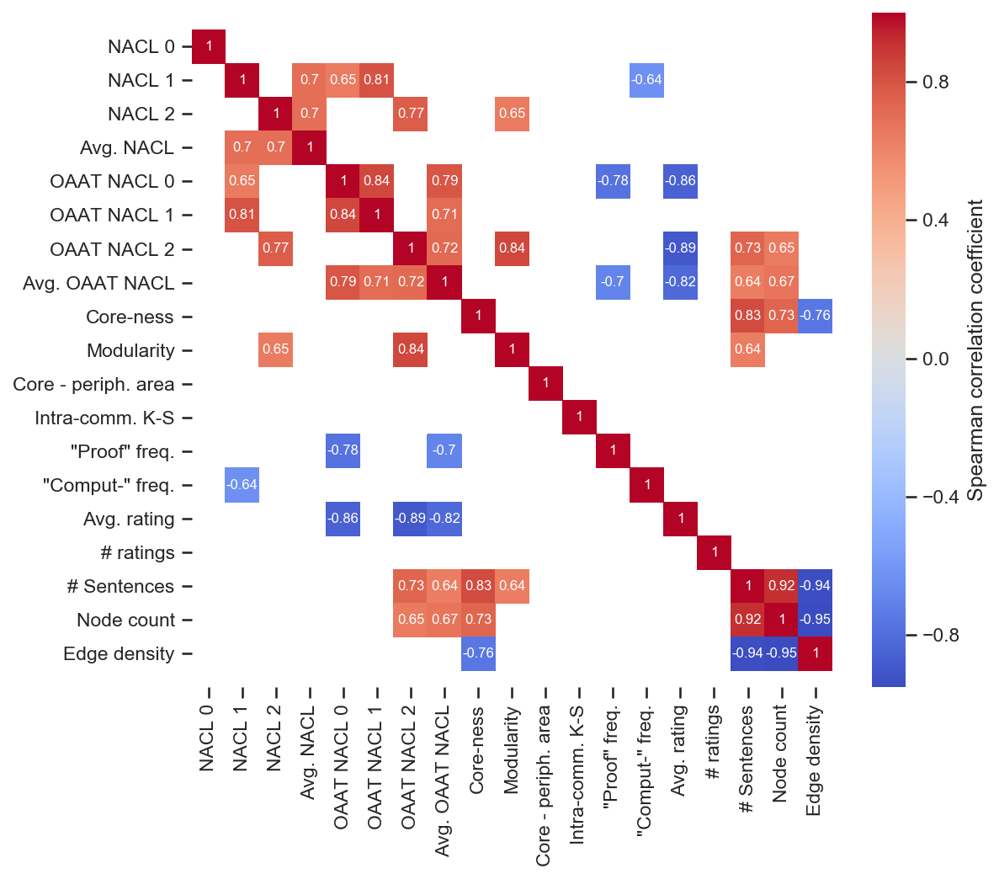

In [84]:
correlationMatrix = corr_df.corr(method='spearman')
plt.figure(figsize=(8, 7), dpi=150)
sns.heatmap(correlationMatrix, annot=True, cmap='coolwarm', mask=corrs>=0.05, cbar_kws={'label':'Spearman correlation coefficient'})
plt.gca().set_ylim(len(corr_df.columns)+0.5, -0.5)
# sns.heatmap(correlationMatrix, annot=True, cbar=True, mask=np.abs(correlationMatrix<0.64), cmap='coolwarm', square=True)
plt.tight_layout()
plt.savefig('figures/spearman_corr.png', 
            transparent=True, bbox_inches='tight')
plt.show()

In [63]:
for col in corr_df.columns[1:]:
    if col == 'Avg. ratings' or col == 'nratings':
        tmp_df = corr_df.dropna()
    else:
        tmp_df = corr_df
    W, p = st.shapiro(tmp_df[col])
    if p < 0.05:
        print(col, p)

ndens0 0.03940686583518982
nproof 0.024307824671268463
ncalculat 1.7564912923262455e-05
nratings 0.0027534610126167536


In [92]:
pg.corr(corr_df['Avg. rating'], corr_df['# ratings'], method='spearman')

,n,r,CI95%,r2,adj_r2,p-val,power
spearman,7,0.464,"[-0.44, 0.9]",0.216,-0.177,0.293934,0.19


In [90]:
for col in corr_df.columns[:8]:
    sp_corr = pg.corr(corr_df[col], corr_df['Avg. rating'], method='spearman')
    pea_corr = pg.corr(corr_df[col], corr_df['Avg. rating'], method='pearson')
    print(col)
    print('spearman', sp_corr['r'][0], sp_corr['p-val'][0])
    print('pearson', pea_corr['r'][0], pea_corr['p-val'][0])
    print()

NACL 0
spearman 0.143 0.7599453002180929
pearson 0.466 0.2914736657792087

NACL 1
spearman 0.036 0.9394082054712856
pearson -0.334 0.46361004903174813

NACL 2
spearman 0.0 1.0
pearson -0.145 0.7572229760965831

Avg. NACL
spearman 0.071 0.8790481931481541
pearson -0.187 0.6886656504573547

OAAT NACL 0
spearman -0.857 0.01369732661532562
pearson -0.821 0.023657461245799274

OAAT NACL 1
spearman -0.5 0.25316999510032273
pearson -0.575 0.1773143924264162

OAAT NACL 2
spearman -0.893 0.006807187408935392
pearson -0.846 0.016300064178063556

Avg. OAAT NACL
spearman -0.821 0.023448808345691505
pearson -0.828 0.021325122149299974



In [66]:
import pingouin as pg
for i in ['oaat ndens0', 'oaat ndens1', 'oaat ndens2']:
    for j in ['ndet', 'nproof', 'nsystem', 'ncalculat', 'ncomp', 'ratings']:
        if j == 'ratings' or j == 'nratings':
            tmp_df = corr_df.dropna()
        else:
            tmp_df = corr_df
        Norm, p = pg.multivariate_normality(np.array([tmp_df[i], tmp_df[j]]).T, alpha=.05)
        print(Norm, i, j, p)

True oaat ndens0 ndet 0.740703025092502
True oaat ndens0 nproof 0.3922548673241682
True oaat ndens0 nsystem 0.6447391495384531
False oaat ndens0 ncalculat 0.009003304401545219
True oaat ndens0 ncomp 0.33875372542688076
True oaat ndens0 ratings 0.224616091461877
True oaat ndens1 ndet 0.27713352510818295
True oaat ndens1 nproof 0.3576617023077846
True oaat ndens1 nsystem 0.23352024443208996
False oaat ndens1 ncalculat 0.00984111585396212
True oaat ndens1 ncomp 0.5595255683455993
True oaat ndens1 ratings 0.3921542667651084
True oaat ndens2 ndet 0.45789746700926603
True oaat ndens2 nproof 0.08290427028356051
False oaat ndens2 nsystem 0.027655745773964832
False oaat ndens2 ncalculat 0.0051136119274868995
True oaat ndens2 ncomp 0.19657935418417266
True oaat ndens2 ratings 0.4088344350651463


In [87]:
st.spearmanr((-corr_df.dropna()['oaat ndens0'] + corr_df.dropna()['oaat ndens1'] + corr_df.dropna()['oaat ndens2'])/3, corr_df.dropna()['ratings'])

SpearmanrResult(correlation=-0.8214285714285715, pvalue=0.023448808345691505)

sent 0 pearson          n      r         CI95%     r2  adj_r2     p-val   BF10  power
pearson  7  0.466  [-0.44, 0.9]  0.218  -0.174  0.291474  0.743  0.191
sent 0 spearman           n      r          CI95%    r2  adj_r2     p-val  power
spearman  7  0.143  [-0.68, 0.81]  0.02  -0.469  0.759945   0.06
sent 1 pearson          n      r          CI95%     r2  adj_r2    p-val   BF10  power
pearson  7 -0.334  [-0.87, 0.56]  0.112  -0.332  0.46361  0.579  0.115
sent 1 spearman           n      r          CI95%     r2  adj_r2     p-val  power
spearman  7  0.036  [-0.74, 0.77]  0.001  -0.498  0.939408   0.05
sent 2 pearson          n      r          CI95%     r2  adj_r2     p-val   BF10  power
pearson  7 -0.145  [-0.81, 0.68]  0.021  -0.469  0.757223  0.477  0.061
sent 2 spearman           n    r          CI95%   r2  adj_r2  p-val  power
spearman  7  0.0  [-0.75, 0.75]  0.0    -0.5    1.0  0.049
sent 3 pearson          n      r          CI95%     r2  adj_r2     p-val   BF10  power
pearson  7 -

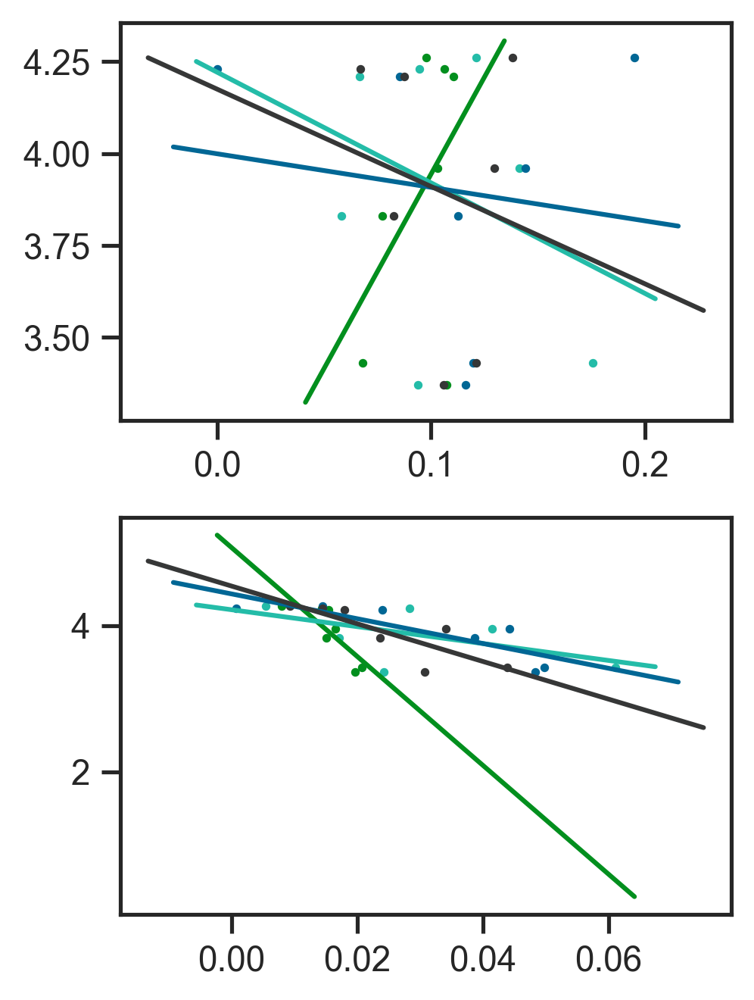

In [248]:
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42

tmp_df = corr_df.dropna()

colors = ['xkcd:emerald green', 'xkcd:tealish', 'xkcd:peacock blue', 'xkcd:dark grey']
dens_type = ['sent', 'oaat']
metric_name = ['Dimension 0', 'Dimension 1', 'Dimension 2', 'Average']
fig, ax = plt.subplots(2, 1, figsize=(3.42, 4.5), dpi=300)
for i in range(2):
    stuff = []
    for d in range(4):
        if d < 3:
            dens = '{}ndens{}'.format(dens_type[i], d)
        else:
            dens = 'avg{}dens'.format(dens_type[i])
        
        m,b,r,p,s = st.linregress(tmp_df[dens], tmp_df['ratings'])
        ax[i].scatter(tmp_df[dens], tmp_df['ratings'], 
                    color=colors[d], s=3,
                    label=metric_name[d])
        print(dens_type[i], d, 'pearson', pg.corr(tmp_df[dens], tmp_df['ratings'], method='pearson'))
        print(dens_type[i], d, 'spearman', pg.corr(tmp_df[dens], tmp_df['ratings'], method='spearman'))
        stuff.append((m,b,r,p,s))
    for d in range(4):
        m,b,r,p,s = stuff[d]
        x = list(ax[i].get_xlim())
        y = ax[i].get_ylim()
        if m > 0:
            x[0] = np.max([x[0], (y[0]-b)/m])
            x[1] = np.min([x[1], (y[1]-b)/m])
        else:
            x[0] = np.min([x[0], (y[0]-b)/m])
            x[1] = np.max([x[1], (y[1]-b)/m])
        x = np.linspace(x[0], x[1], 2)
        ax[i].plot(x, m*x+b, color=colors[d], zorder=1)
plt.tight_layout()
plt.savefig('figures/all_correlation.pdf'.format(i), 
            transparent=True, bbox_inches='tight')
plt.show()

In [145]:
all_ratings = np.array([[0,0,2,3,1],
               [9, 27, 92, 193, 352],
                [0,1,5,11,14],
                [9, 8, 19, 18, 17],
                [0,1,3,2,1],
                [1,1,6,7,10],
                [21,41,114,268,447]])
X0s = []
X1s = []
X2s = []
rates = []
for i in range(7):
    for j in range(5):
        X0s += [np.mean(true_oaat_density, axis=1)[:, 2, 0][sel_texts][i]] * all_ratings[i, j]
        X1s += [np.mean(true_oaat_density, axis=1)[:, 2, 1][sel_texts][i]] * all_ratings[i, j]
        X2s += [np.mean(true_oaat_density, axis=1)[:, 2, 2][sel_texts][i]] * all_ratings[i, j]
        rates += [j+1] * all_ratings[i, j]
X0s = np.array(X0s)
X1s = np.array(X1s)
X2s = np.array(X2s)
rates = np.array(rates)

In [146]:
print(st.spearmanr(X0s, rates))
print(st.spearmanr(X1s, rates))
print(st.spearmanr(X2s, rates))

SpearmanrResult(correlation=-0.08803586590754983, pvalue=0.00027425294378506253)
SpearmanrResult(correlation=-0.09103641395317173, pvalue=0.0001678878151440926)
SpearmanrResult(correlation=-0.08941106464014051, pvalue=0.00021941796821713227)


In [126]:
st.spearmanr(X2s, rates)

SpearmanrResult(correlation=-0.08941106464014051, pvalue=0.00021941796821713227)

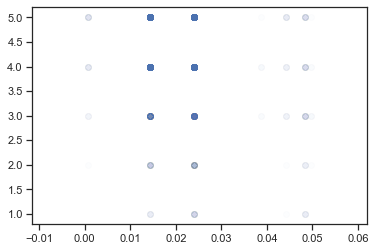

In [149]:
plt.scatter(X2s, rates, alpha=0.01)

In [36]:
for feat in ['ndet', 'nproof', 'nsystem', 'ncomp', 'ncalculat', 'napplic']:
    for d in range(3):
        m,b,r,p,s = st.linregress(corr_df[feat], corr_df['ndens{}'.format(d)])
        if p < 0.05:
            print(feat, r, p)

nsystem 0.750212336990812 0.012439020950441974
nsystem 0.706510192873832 0.022367447004481133
ncomp -0.7023906543018111 0.02351944450045979
ncalculat 0.8420070911773327 0.002242441915898249
ncalculat 0.8209407534788823 0.0036013222247895656


In [38]:
corr_df['ncalculat']

0    0.001497
1    0.002133
2    0.007260
3    0.000000
4    0.007837
5    0.046196
6    0.000315
7    0.001462
8    0.007830
9    0.002645
Name: ncalculat, dtype: float64

Determinant 0 -0.4578189924334457 0.1833487192068417
Determinant 1 -0.015318573631788911 0.9664984823408562
Determinant 2 0.5150876358146917 0.12760827523691756
Determinant 3 -0.16637517981815436 0.6459623512020636


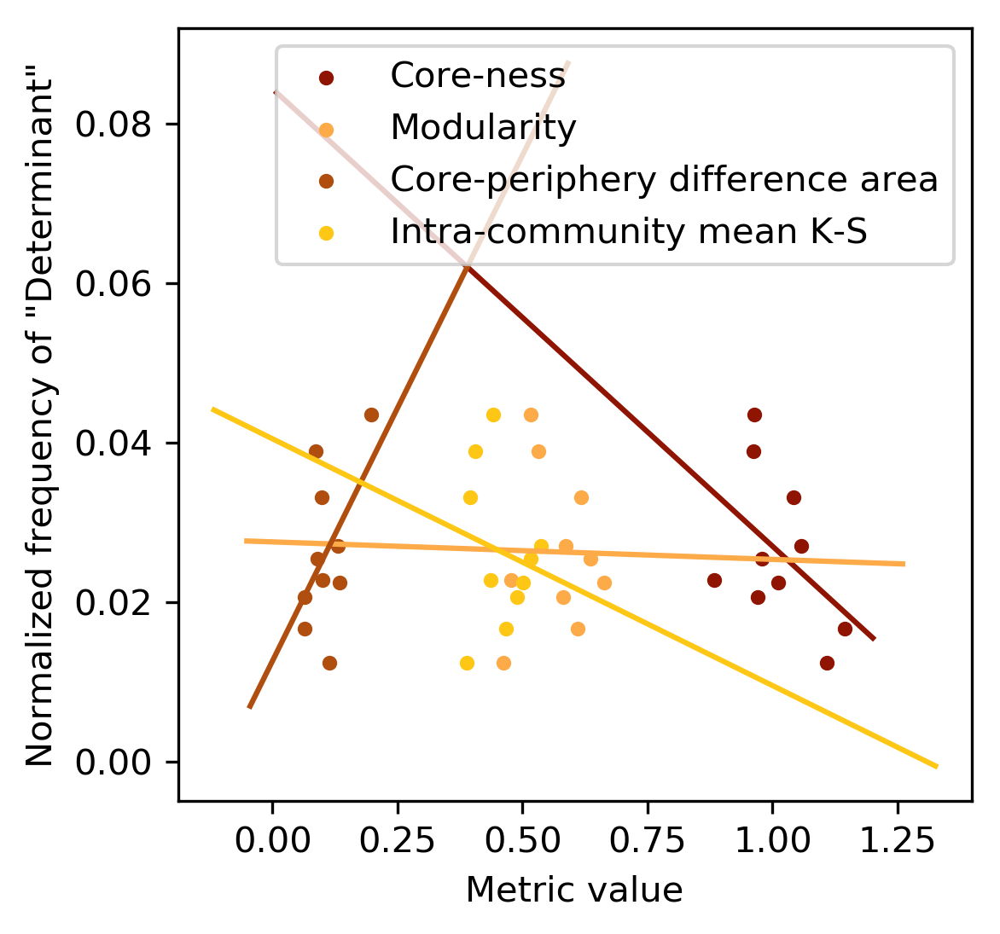

Proof 0 -0.18939854928739602 0.6002355544499612
Proof 1 -0.026047257768818263 0.9430602654252724
Proof 2 -0.161026412569884 0.6567470486454725
Proof 3 -0.06805790581177636 0.8518109953720971


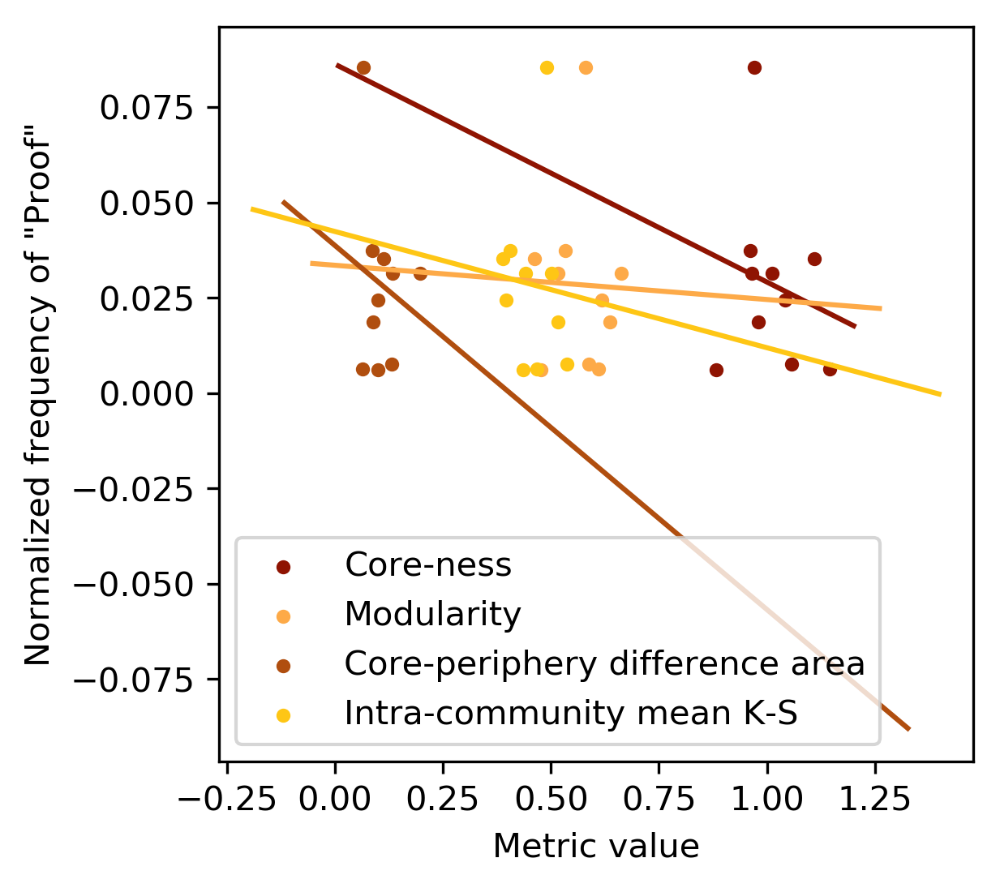

System 0 -0.2585950010949816 0.4706574208607601
System 1 -0.08220137825903064 0.8213945923868585
System 2 -0.2590631469524215 0.46982568649262757
System 3 -0.19946247729860134 0.580624649164881


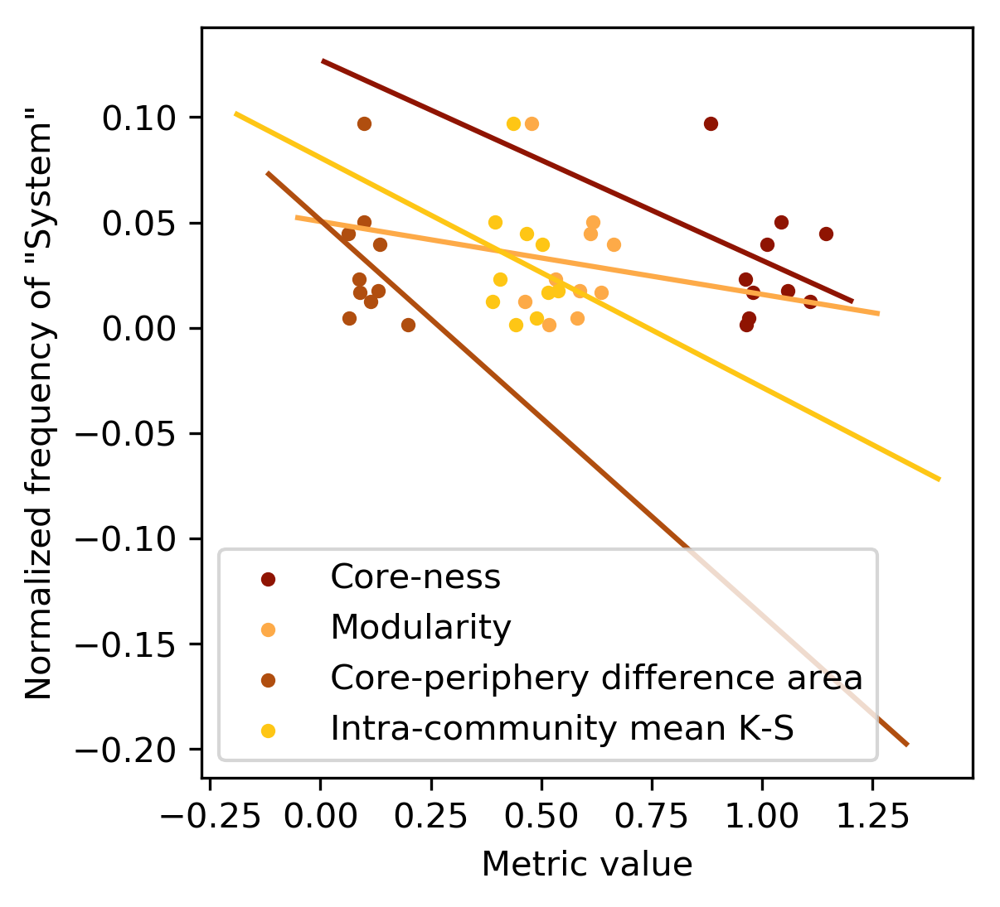

Comput 0 0.3230808178083279 0.3625256989574352
Comput 1 0.26615361423775225 0.45730813493590006
Comput 2 0.5378698930097798 0.10878578372210271
Comput 3 0.11804410762493531 0.7453466957916881


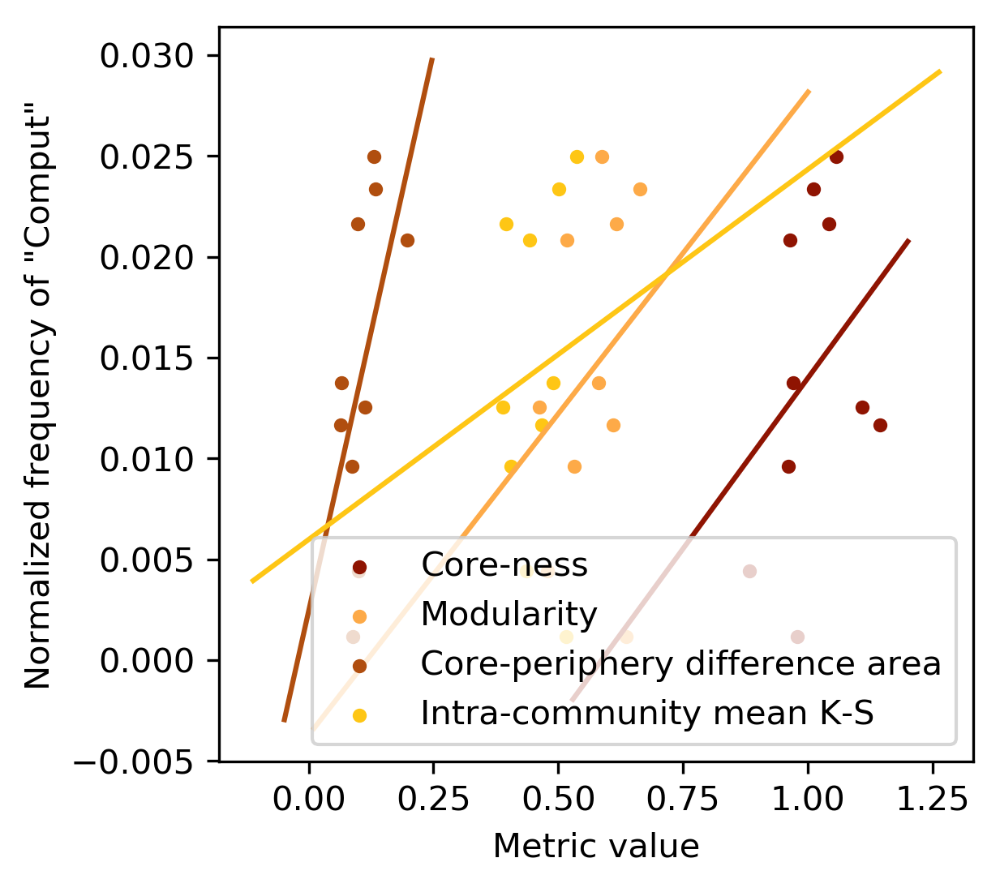

Rating 0 -0.48655235688115384 0.2681963421790444
Rating 1 -0.6226376369335831 0.1353303407132192
Rating 2 0.22910507259669294 0.6211858550324432
Rating 3 -0.16711014443249514 0.7202495639799038


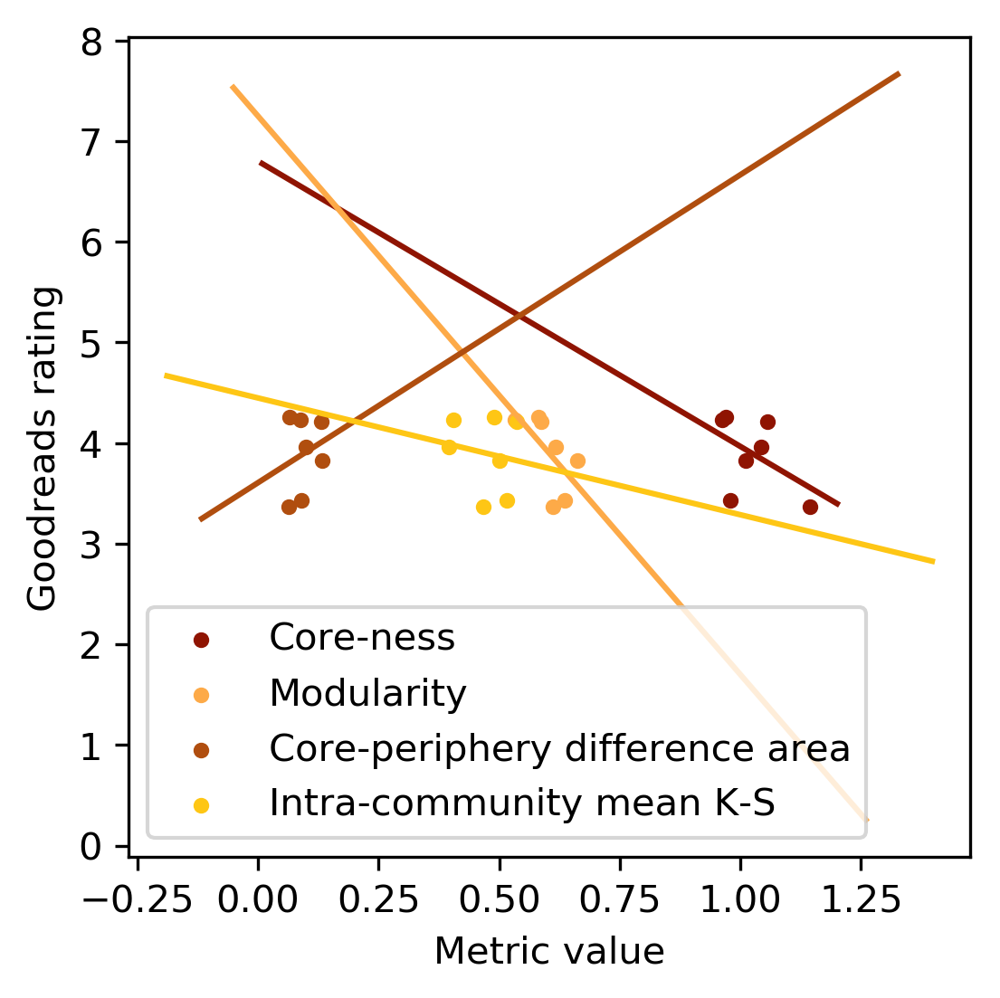

In [246]:
colors = ['xkcd:brick red', 'xkcd:light orange', 'xkcd:burnt sienna',
          'xkcd:golden yellow']
features = [num_det, num_proof, num_system, num_comp, ratings]
names = ['Determinant', 'Proof', 'System', 'Comput', 'Rating']
metric = [true_qc, true_qm, true_diff_areas, true_comm_ks]
metric_name = ['Core-ness', 'Modularity', 'Core-periphery difference area',
               'Intra-community mean K-S']
for i in range(5):
    plt.figure(figsize=(4, 4), dpi=300)
    stuff = []
    for d in range(4):
        if i < 4:
            m,b,r,p,s = st.linregress(metric[d], features[i])
            plt.scatter(metric[d], 
                    features[i], color=colors[d], s=10,
                    label=metric_name[d])
        else:
            m,b,r,p,s = st.linregress(np.array(metric[d])[sel_texts], features[i])
            plt.scatter(np.array(metric[d])[sel_texts], 
                    features[i], color=colors[d], s=10,
                    label=metric_name[d])
        stuff.append((m,b,r,p,s))
        print(names[i], d, r, p)
        
    for d in range(4):
        m,b,r,p,s = stuff[d]
        x = list(plt.xlim())
        y = plt.ylim()
        if m > 0:
            x[0] = np.max([x[0], (y[0]-b)/m])
            x[1] = np.min([x[1], (y[1]-b)/m])
        else:
            x[0] = np.min([x[0], (y[0]-b)/m])
            x[1] = np.max([x[1], (y[1]-b)/m])
        x = np.linspace(x[0], x[1], 2)
        plt.plot(x, m*x+b, color=colors[d], zorder=1)
    plt.legend()
    plt.xlabel('Metric value')
    if i < 4:
        plt.ylabel('Normalized frequency of "{}"'.format(names[i]))
    else:
        plt.ylabel('Goodreads rating')
    plt.savefig('figures/correlation_struc_{}.pdf'.format(names[i]), 
                transparent=True, bbox_inches='tight')
    plt.show()

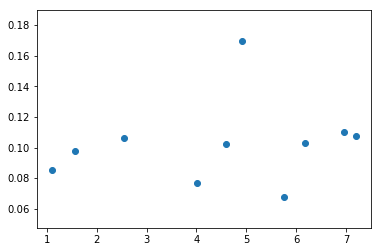

In [392]:
plt.scatter(true_sent_density[:, 0, 0], true_sent_density[:, 2, 0])

1 3 0.6510446228732472 0.04145994357787993


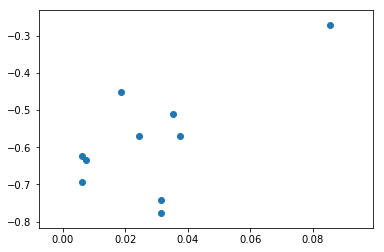

In [235]:
stuff = [(true_qc -m_r_ind_qc), (true_qm-m_r_ind_qm), 
         (true_diff_areas-m_r_ind_diff_areas), (true_comm_ks-r_ind_comm_ks)]
for d in range(len(features)-1):
    for i in range(len(stuff)):
        m,b,r,p,s = st.linregress(features[d],
                                  stuff[i])
        if p < 0.05:
            print(d, i, r, p)
            plt.scatter(features[d], stuff[i])
            plt.show()

Goodreads ratings

In [395]:
st.linregress(true_sent_density[:, 2, 0], np.mean(true_oaat_density, axis=1)[:, 2, 0])

LinregressResult(slope=0.07455592167777166, intercept=0.008221450036005284, rvalue=0.42534844577983627, pvalue=0.2204020339335107, stderr=0.056086083701005957)

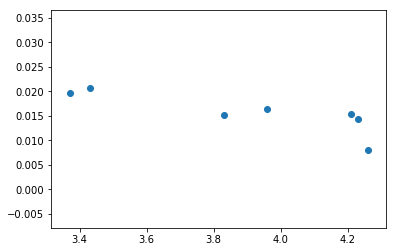

In [401]:
plt.scatter(ratings, np.mean(true_oaat_density, axis=1)[:, 2, 0][sel_texts])

Goodreads 0 0.4663756508557751 0.29147366577920863
Goodreads 1 -0.3343267667950477 0.46361004903174824
Goodreads 2 -0.1445116972485936 0.7572229760965831


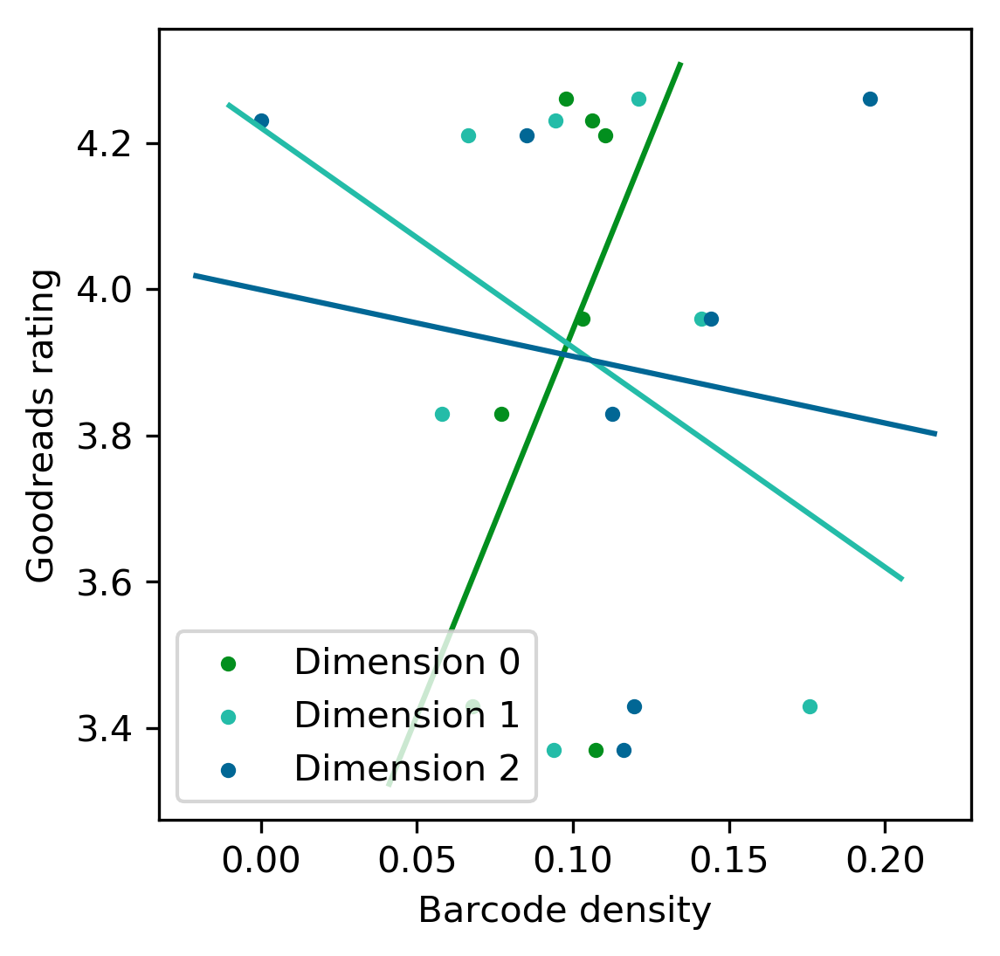

In [403]:
plt.figure(figsize=(4, 4), dpi=300)
stuff = []
for d in range(3):
    m,b,r,p,s = st.linregress(true_sent_density[:, 0, d][sel_texts], 
                              ratings)
    stuff.append((m,b,r,p,s))
    print('Goodreads', d, r, p)
    plt.scatter(true_sent_density[:, 0, d][sel_texts], 
                ratings, color=colors[d], s=10,
                label='Dimension {}'.format(d))
for d in range(3):
    m,b,r,p,s = stuff[d]
    x = list(plt.xlim())
    y = plt.ylim()
    if m > 0:
        x[0] = np.max([x[0], (y[0]-b)/m])
        x[1] = np.min([x[1], (y[1]-b)/m])
    else:
        x[0] = np.min([x[0], (y[0]-b)/m])
        x[1] = np.max([x[1], (y[1]-b)/m])
    x = np.linspace(x[0], x[1], 2)
    plt.plot(x, m*x+b, color=colors[d], zorder=1)
plt.legend()
plt.xlabel('Barcode density')
plt.ylabel('Goodreads rating'.format(names[i]))
plt.savefig('figures/correlation_goodreads.pdf'.format(names[i]), 
            transparent=True, bbox_inches='tight')
plt.show()

Text length 0 0.33698543684079374 0.3410056884754465
Text length 1 -0.05484176361026781 0.8803938045574673
Text length 2 0.7009931556423339 0.023919332691683684


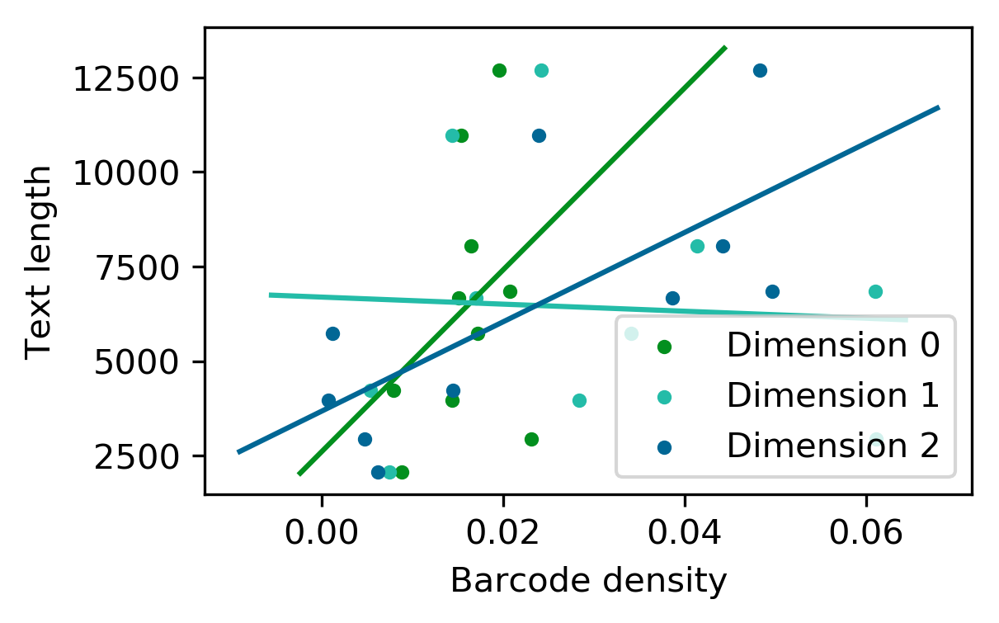

Index size 0 0.33331868598762426 0.3466160109248082
Index size 1 0.0331148932080549 0.9276405549964384
Index size 2 0.6546567898833274 0.03996725059481008


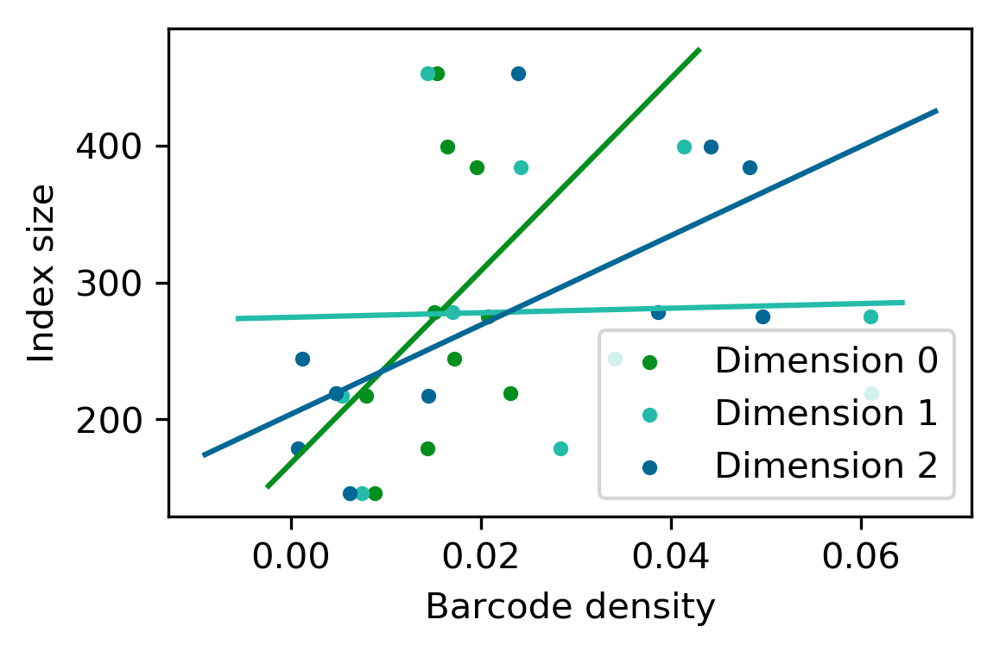

Edge density 0 -0.4683182914850193 0.1722144894420237
Edge density 1 -0.19148970841682755 0.5961410414137267
Edge density 2 -0.8330653541767348 0.002763146582002202


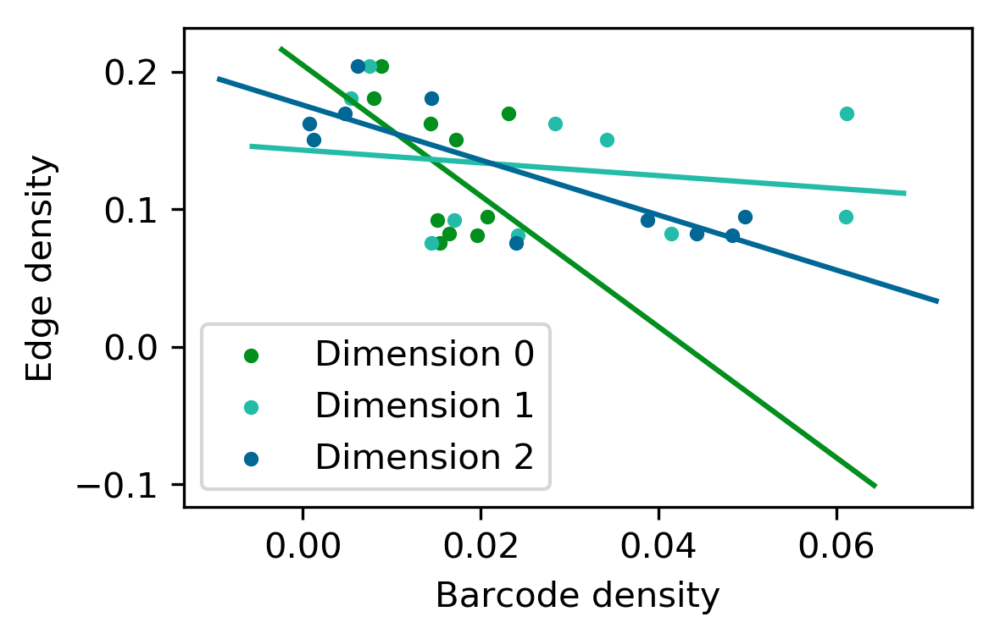

In [495]:

colors = ['xkcd:emerald green', 'xkcd:tealish', 'xkcd:peacock blue']
names = ['Text length', 'Index size', 'Edge density']
for i in range(3):
    plt.figure(figsize=(4, 2.5), dpi=300)
    stuff = []
    for d in range(3):
        m,b,r,p,s = st.linregress(np.mean(true_density, axis=1)[:, 2, d], 
                                  features[i])
        stuff.append((m,b,r,p,s))
        print(names[i], d, r, p)
        plt.scatter(np.mean(true_density, axis=1)[:, 2, d], 
                    features[i], color=colors[d], s=10,
                    label='Dimension {}'.format(d))
    for d in range(3):
        m,b,r,p,s = stuff[d]
        x = list(plt.xlim())
        y = plt.ylim()
        if m > 0:
            x[0] = np.max([x[0], (y[0]-b)/m])
            x[1] = np.min([x[1], (y[1]-b)/m])
        else:
            x[0] = np.min([x[0], (y[0]-b)/m])
            x[1] = np.max([x[1], (y[1]-b)/m])
        x = np.linspace(x[0], x[1], 2)
        plt.plot(x, m*x+b, color=colors[d], zorder=1)
    plt.legend()
    plt.xlabel('Barcode density')
    plt.ylabel('{}'.format(names[i]))
    plt.savefig('figures/correlation_{}.pdf'.format(names[i]), 
                transparent=True, bbox_inches='tight')
    plt.show()

In [18]:
num_trace = count_occ('trace', all_texts, text_lens)# good
num_system = count_occ('system', all_texts, text_lens) # good

num_proof = count_occ('applied', all_texts, text_lens) # good
num_spectral = count_occ('comput', all_texts, text_lens) # good
num_comp = count_occ('comput', all_texts, text_lens) # good
num_thm = count_occ('row reduction', all_texts, text_lens)
num_var = avg_occ('determinant', all_texts, text_lens)
num_num = count_occ('#', all_texts, text_lens)
n_index = [len(l) for l in labels]
num_thm = count_occ('row reduction', all_texts, text_lens)

features = [num_det, num_proof, num_system, num_comp, num_thm]

NameError: name 'all_texts' is not defined

In [199]:
st.linregress(num_dual, [len(l) for l in labels])

LinregressResult(slope=37223.812353606605, intercept=256.0375632742349, rvalue=0.34018125852207387, pvalue=0.3361540143232739, stderr=36379.73799226332)

In [505]:
num_proof

array([0.00898069, 0.01303318, 0.01984511, 0.00631632, 0.00191571,
       0.00373641, 0.00566795, 0.00482386, 0.0101914 , 0.00729594])

In [19]:
np.mean(r_ind_density, axis=1)[:, 0, 0]

array([ 9.51097717, 12.80937221,  8.56344397, 12.94783968, 14.71868996,
       18.02975132, 26.02706087,  9.69239849, 19.98383548, 20.21440336])

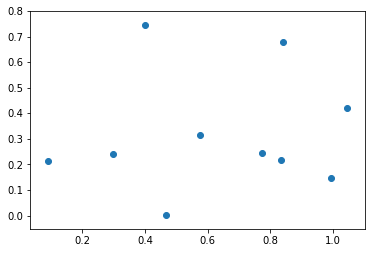

In [23]:
%matplotlib inline
plt.scatter(np.mean(r_ind_density, axis=1)[:, 0, 2], where_det)

goodreads ratings no edwards, no petersen, no robbiano

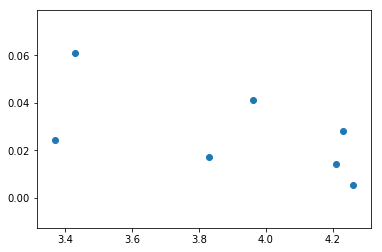

In [49]:
plt.scatter(ratings, np.mean(true_density, axis=1)[:, 2, 1][np.array([0, 1, 3, 6, 7, 8,9])])

In [19]:
texts

['Wrong',
 'Axler',
 'Edwards',
 'Lang',
 'Petersen',
 'Robbiano',
 'Bretscher',
 'Greub',
 'Hefferson',
 'Strang']

In [56]:
from bct import core_periphery_dir, community_louvain

true_cms = load_sent_coocs()

true_C, true_qc = [], []
true_M, true_qm = [], []
for true_cm in tqdm_notebook(true_cms):
    C, qc = core_periphery_dir(true_cm)
    true_C.append(C)
    true_qc.append(qc)
    # get the periphery indices only
    P = np.array(1 - C, dtype=bool) 
    M, qm = community_louvain(true_cm[P, :][:, P])
    true_M.append(M)
    true_qm.append(qm)
    
r_ind_C = load_r_ind_C()
r_ind_qc = load_r_ind_qc()
r_ind_M = load_r_ind_M()
r_ind_qm = load_r_ind_qm()

r_sentord_C = load_r_sentord_C()
r_sentord_qc = load_r_sentord_qc()
r_sentord_M = load_r_sentord_M()
r_sentord_qm = load_r_sentord_qm()

In [57]:
true_oaat_filts = load_oaat_filt_mats()

In [70]:
oaat_bars[0][0][1]

[(0, array([[5.000e+00, 8.000e+00],
         [3.000e+00, 9.000e+00],
         [7.000e+00, 1.000e+01],
         [6.000e+00, 1.100e+01],
         [4.000e+00, 1.200e+01],
         [2.300e+01, 2.500e+01],
         [2.400e+01, 2.600e+01],
         [3.300e+01, 3.500e+01],
         [3.400e+01, 3.600e+01],
         [4.200e+01, 4.300e+01],
         [4.400e+01, 4.500e+01],
         [5.500e+01, 5.700e+01],
         [5.600e+01, 5.800e+01],
         [5.400e+01, 6.700e+01],
         [7.000e+01, 7.100e+01],
         [7.400e+01, 7.500e+01],
         [3.200e+01, 8.300e+01],
         [2.000e+00, 8.900e+01],
         [9.300e+01, 9.400e+01],
         [9.200e+01, 9.600e+01],
         [1.010e+02, 1.020e+02],
         [1.000e+02, 1.040e+02],
         [1.070e+02, 1.080e+02],
         [1.090e+02, 1.100e+02],
         [1.140e+02, 1.160e+02],
         [1.130e+02, 1.170e+02],
         [1.120e+02, 1.190e+02],
         [1.150e+02, 1.230e+02],
         [1.420e+02, 1.430e+02],
         [1.520e+02, 1.530e+02],
       

In [63]:
i, j = np.where(true_filts[0][0] == 13)[0]
i, j

(3, 5)

In [82]:
# takes an oaat filt matrix, core and periphery groupings, and barcode
# to count how many cycles are killed by edges of what type
def kill_edge(oaat, C, M, bars, density):
    groups = 1 - C
    groups[groups == 1] = M # replace periphery with community assignments
    # 2 dimensions, first will be homology dimension, 2nd will be type
    # of edge, in order: core-core, core-periphery, peri-peri, and 
    # intra-community
    res = np.zeros((3, 4))
    res_weighted = np.zeros((3, 4))
    res_edgenorm = np.zeros((3, 4))
    res_weightednorm = np.zeros((3, 4))
    type_counts = np.zeros(4)
    for d in range(1,3):
        for bar in bars[1][d][1]:
#             if not np.isinf(bar[1]):
            i, j = np.where(oaat == bar[0])[0]
            if groups[i] == groups[j] and groups[i] == 0:
                index = 0
                type_counts[0] += 1
            elif groups[i] == groups[j] and groups[i] != 0:
                index = 3
                type_counts[3] += 1
            elif groups[i] == 0 or groups[j] == 0:
                index = 1
                type_counts[1] += 1
            else:
                index = 2
                type_counts[2] += 1
            res[d, index] += 1
            res_weighted[d, index] += (bar[1] - bar[0])/density[0, d]
    res_edgenorm = res / type_counts
    res_weightednorm = res_weighted / type_counts
    return res, res_weighted, res_edgenorm, res_weightednorm

In [83]:
# does the same thing, but for an entire ensemble (whether oaat or null)
def all_ensemble_kill_edge(oaats, Cs, Ms, bars, density, null=False):
    ensembles = []
    for i in tqdm_notebook(range(10)):
        ensemble = []
        for j in range(100):
            if not null:
                tmp_C, tmp_M = Cs[i], Ms[i]
            else:
                tmp_C, tmp_M = Cs[i][j], Ms[i][j]
            ensemble.append(kill_edge(oaats[i][j], tmp_C, 
                                      tmp_M, bars[i][j], density[i][j]))
        ensembles.append(np.stack(ensemble))
    return np.stack(ensembles)

In [77]:
true_density.shape

NameError: name 'true_density' is not defined

In [84]:
r_ind_oaats = load_r_ind_oaat_mats()
r_sentord_oaats = load_r_sentord_oaat_mats()

oaat_kills = all_ensemble_kill_edge(true_oaat_filts, true_C, 
                                    true_M, oaat_bars, true_oaat_density)
r_ind_kills = all_ensemble_kill_edge(r_ind_oaats, r_ind_C, 
                                     r_ind_M, r_ind_oaat_bars, 
                                     r_ind_oaat_density, null=True)
r_sentord_kills = all_ensemble_kill_edge(r_sentord_oaats, r_sentord_C, 
                                         r_sentord_M, r_sentord_oaat_bars, 
                                         r_sentord_oaat_density, null=True)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:32: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:33: RuntimeWarning: invalid value encountered in true_divide


In [61]:
import pandas as pd
plottexts = ['Treil', 'Axler', 'Edwards', 'Lang', 'Petersen', 'Robbiano',
             'Bretscher', 'Greub', 'Hefferson', 'Strang']
weights = ['non-weighted', 'weighted', 'non-normed', 'weighted-normed']
edge_types = ['CC', 'CP', 'PP', 'IC']
data = [oaat_kills, r_ind_kills, r_sentord_kills]
models = ['True networks', 'Random index null', 'Random sentence order null']

big_df = []
for dat in range(len(data)):
    for text in range(data[dat].shape[0]):
        for j in range(data[dat].shape[2]):
            for d in range(data[dat].shape[3]):
                for l in range(data[dat].shape[4]):
                    df = pd.DataFrame({'Text': plottexts[text],
                                  'Weighted':weights[j],
                                  'Dimension':d,
                                  'Edge type':edge_types[l],
                                  'Model': models[dat],
                                  'Number of killing edges':data[dat][text, :, j, d, l]})
                    big_df.append(df)
big_df = pd.concat(big_df)

non-weighted


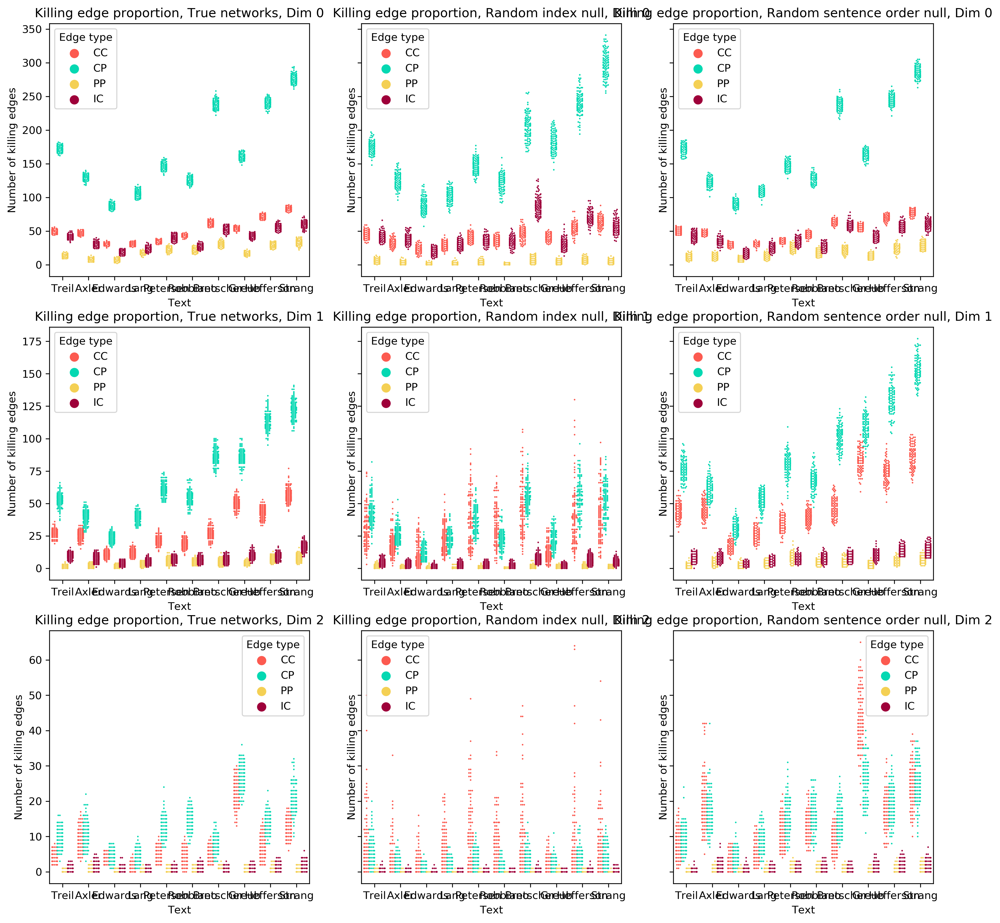

weighted


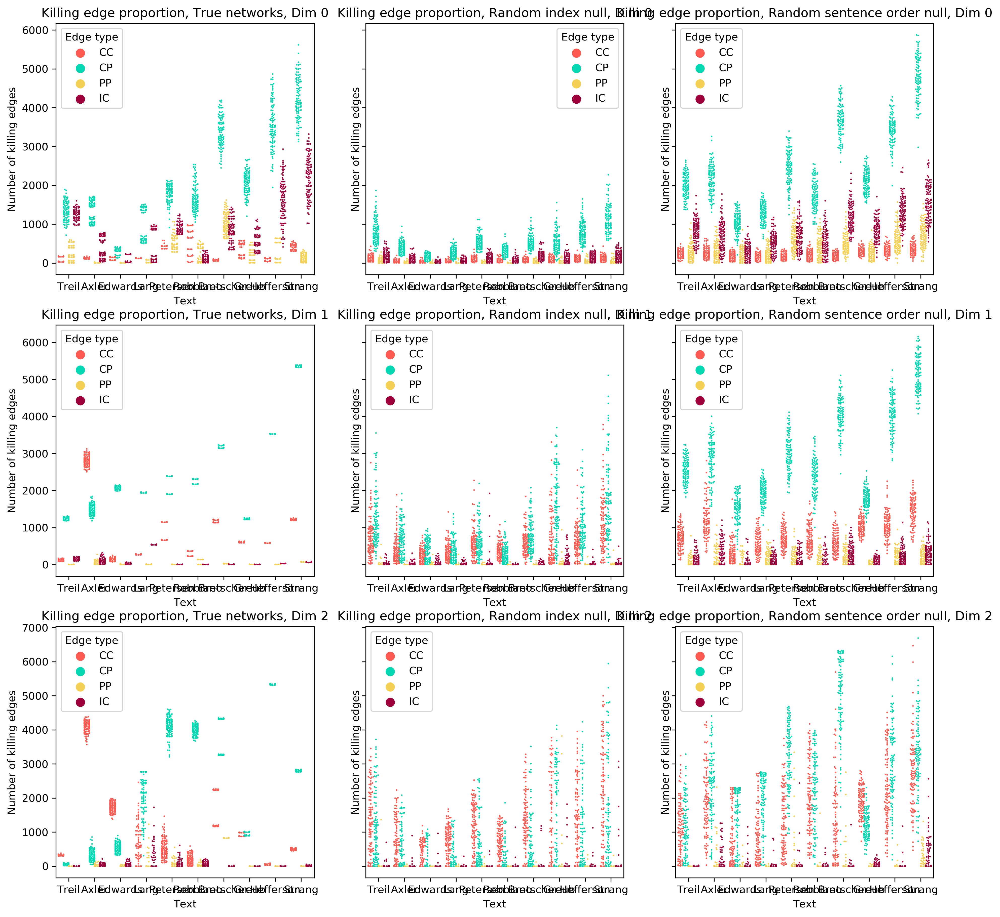

non-normed


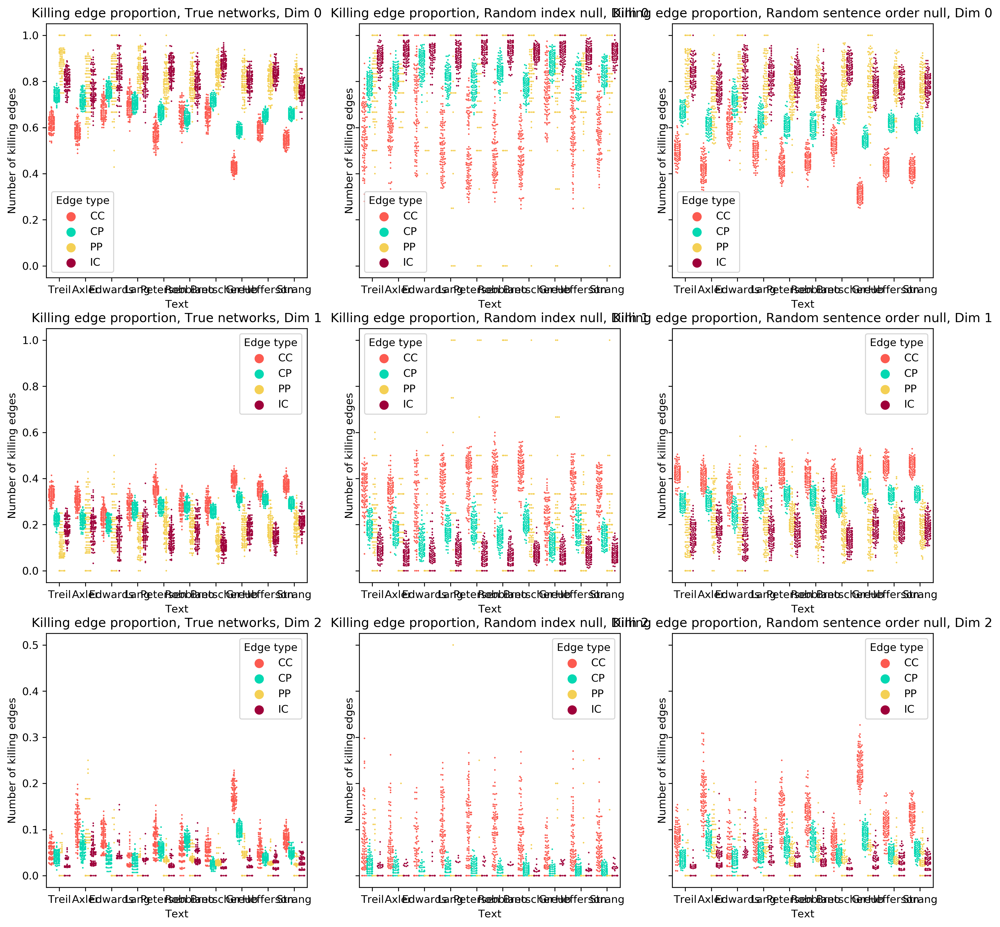

weighted-normed


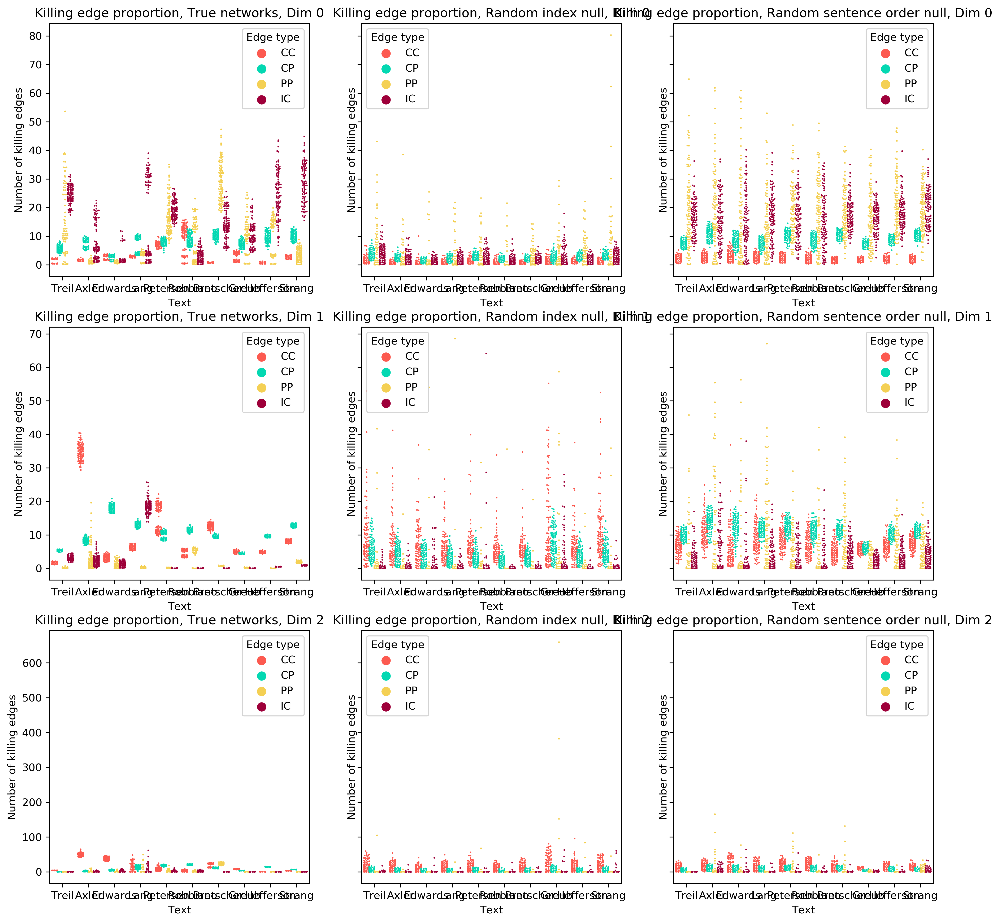

In [62]:
colors = ['xkcd:coral', 'xkcd:aquamarine',
          'xkcd:maize', 'xkcd:cranberry']
for j in range(4):
    print(weights[j])
    fig, ax = plt.subplots(3, 3, sharey='row', figsize=(15, 15), dpi=300)
    for d in range(3):
        for i in range(3):
            #plt.subplot(1, 3, i+1, sharey=True)
            #plt.yscale('log')
            dim_df = big_df.loc[(big_df['Dimension'] == d) 
                                & (big_df['Weighted'] == weights[j])
                                & (big_df['Model'] == models[i])]
            sns.swarmplot(x='Text', y='Number of killing edges', hue='Edge type', data=dim_df, 
                          size=1.5, dodge=True, palette=colors, zorder=2, ax=ax[d, i])
        #     sns.boxplot(x='text', y='density', hue='model', 
        #                 data=dim_df, color='black', zorder=1)
            ax[d, i].title.set_text('Killing edge proportion, {}, Dim {}'.format(models[i], d))
            #plt.savefig('figures/barcode_density_dim{}_supp.pdf'.format(d), 
                        #transparent=True, bbox_inches='tight')
    plt.show()